In [2]:
# from google.colab import drive
# drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


In [2]:
# import sys
# sys.path.append('/content/gdrive/MyDrive/DL_tutorials/SuperResolution-using-GANs-master/SuperResolution-using-GANs-master/Codes')

In [1]:
import getpass
import os
import torch
import numpy as np
import pandas as pd
from PIL import Image
from torch.utils.data import Dataset
from torchvision import transforms
import matplotlib.pyplot as plt

In [2]:
train_list = pd.read_csv('../dataset/train_filenames.csv', header=None)
test_list = pd.read_csv('../dataset/test_filenames.csv', header=None)
val_list = pd.read_csv('../dataset/val_filenames.csv', header=None)

In [3]:
print(train_list[0][1])

000002.jpg


In [4]:
train_sr = '../dataset/Down_sampled/Train/'
test_sr = '../dataset/Down_sampled/Test/'
val_sr = '../dataset/Down_sampled/Val/'

hr = "../dataset/row_col_trim/"

In [5]:
class SR_Data(Dataset):
    
    def __init__(self, sr_folder, hr_folder, file_list):
        self.sr_folder = sr_folder
        self.hr_folder = hr_folder
        self.file_list = file_list
        
    def __len__(self):
        return len(self.file_list)
    
    def __getitem__(self, idx):
        set_of_transforms = transforms.Compose([
        transforms.ToTensor()
        ])
        return set_of_transforms(Image.open(self.sr_folder+str(self.file_list[idx])).convert('RGB')), set_of_transforms(Image.open(self.hr_folder+str(self.file_list[idx])).convert('RGB'))

In [6]:
train_data = SR_Data(train_sr, hr, train_list[0])
test_data = SR_Data(test_sr, hr, test_list[0])
val_data = SR_Data(val_sr, hr, val_list[0])

print(len(train_data))
print(len(test_data))
print(len(val_data))

2000
250
250


In [7]:
print(train_data)

In [8]:
train_loader = torch.utils.data.DataLoader(train_data, shuffle = True, batch_size = 2)
val_loader = torch.utils.data.DataLoader(val_data, batch_size = 2)
test_loader = torch.utils.data.DataLoader(test_data, batch_size = 2)

(216, 176, 3)


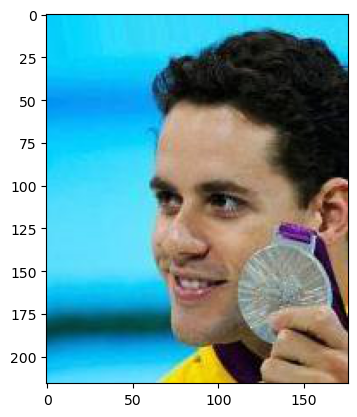

In [9]:
ex = train_data[1500]
img = np.transpose(ex[1].cpu().numpy(), (1, 2, 0))
img = (img)*255
img = img.astype(np.uint8)
print(img.shape)
plt.imshow(img)
plt.show()

In [10]:
import torch
import random
import torch.nn as nn
from torchsummary import summary

In [11]:
random.seed(0)
torch.manual_seed(0)

In [12]:
def define_gpu_to_use(minimum_memory_mb = 3800):
    gpu_to_use = None
    try: 
        os.environ['CUDA_VISIBLE_DEVICES']
        print('GPU already assigned before: ' + str(os.environ['CUDA_VISIBLE_DEVICES']))
        return
    except:
        pass
    torch.cuda.empty_cache()
    for i in range(16):
        free_memory = !nvidia-smi --query-gpu=memory.free -i $i --format=csv,nounits,noheader
        if free_memory[0] == 'No devices were found':
            break
        free_memory = int(free_memory[0])
        if free_memory>2*minimum_memory_mb:
            gpu_to_use = i
            break
    if gpu_to_use is None:
        print('Could not find any GPU available with the required free memory of ' +str(minimum_memory_mb) + 'MB. Please use a different system for this assignment.')
    else:
        os.environ['CUDA_VISIBLE_DEVICES'] = str(gpu_to_use)
        print('Chosen GPU: ' + str(gpu_to_use))
        x = torch.rand((256,1024,minimum_memory_mb-500)).cuda()
        x = torch.rand((1,1)).cuda()
        del x

In [13]:
define_gpu_to_use()

Chosen GPU: 0


In [14]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.convolution_layer_0 = nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = 9, stride = 1, padding = 4)
        self.prelu0 = nn.PReLU()
        self.rb_0 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_1 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_2 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_3 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_4 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.convolution_layer_1 = nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
        self.bn1 = nn.BatchNorm2d(64)
        
        self.convolution_layer_2 = nn.Conv2d(in_channels = 64, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn2 = nn.BatchNorm2d(256)
        self.prelu1 = nn.PReLU()

        self.convolution_layer_3 = nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
        self.trans_conv_0 = nn.ConvTranspose2d(in_channels=256, out_channels = 256, kernel_size = 3, padding = 1, stride =2)
        self.convolution_layer_4 = nn.Conv2d(in_channels = 256, out_channels = 3, kernel_size = 9, stride = 1, padding = 4)

        
    def forward(self, x):
        x = self.convolution_layer_0(x)
        x = self.prelu0(x)
        
        residual1 = x
        
        x = self.rb_0(x)
        x += residual1
        
        residual2 = x
        
        x = self.rb_1(x)
        
        x += residual2
        
        residual3 = x
        
        x = self.rb_2(x)
        
        x += residual3
        
        residual4 = x
        
        x = self.rb_3(x)
        
        x += residual4
        
        residual5 = x
        
        x = self.rb_4(x)
        
        x += residual5

        x = self.convolution_layer_1(x)
        x = self.bn1(x)
        
        x += residual1
        
        x = self.convolution_layer_2(x)
        
        x = nn.functional.interpolate(x, scale_factor=2)
        x = self.bn2(x)
        x = self.prelu1(x)
        
        x = self.convolution_layer_3(x)
        x = self.trans_conv_0(x, output_size = [i * 2 for i in list((x.size()[2:4]))])
        
        x = self.convolution_layer_4(x)
        
        return x       

In [15]:
Gen = Generator()
Gen = Gen.cuda()

In [16]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [17]:
Gen.apply(weights_init)

Generator(
  (convolution_layer_0): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
  (prelu0): PReLU(num_parameters=1)
  (rb_0): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): PReLU(num_parameters=1)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (rb_1): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): PReLU(num_parameters=1)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (rb_2): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=

In [18]:
summary(Gen,ex[0].shape)

Layer (type:depth-idx)                   Output Shape              Param #
├─Conv2d: 1-1                            [-1, 64, 54, 44]          15,616
├─PReLU: 1-2                             [-1, 64, 54, 44]          1
├─Sequential: 1-3                        [-1, 64, 54, 44]          --
|    └─Conv2d: 2-1                       [-1, 64, 54, 44]          36,928
|    └─BatchNorm2d: 2-2                  [-1, 64, 54, 44]          128
|    └─PReLU: 2-3                        [-1, 64, 54, 44]          1
|    └─Conv2d: 2-4                       [-1, 64, 54, 44]          36,928
|    └─BatchNorm2d: 2-5                  [-1, 64, 54, 44]          128
├─Sequential: 1-4                        [-1, 64, 54, 44]          --
|    └─Conv2d: 2-6                       [-1, 64, 54, 44]          36,928
|    └─BatchNorm2d: 2-7                  [-1, 64, 54, 44]          128
|    └─PReLU: 2-8                        [-1, 64, 54, 44]          1
|    └─Conv2d: 2-9                       [-1, 64, 54, 44]          36

Layer (type:depth-idx)                   Output Shape              Param #
├─Conv2d: 1-1                            [-1, 64, 54, 44]          15,616
├─PReLU: 1-2                             [-1, 64, 54, 44]          1
├─Sequential: 1-3                        [-1, 64, 54, 44]          --
|    └─Conv2d: 2-1                       [-1, 64, 54, 44]          36,928
|    └─BatchNorm2d: 2-2                  [-1, 64, 54, 44]          128
|    └─PReLU: 2-3                        [-1, 64, 54, 44]          1
|    └─Conv2d: 2-4                       [-1, 64, 54, 44]          36,928
|    └─BatchNorm2d: 2-5                  [-1, 64, 54, 44]          128
├─Sequential: 1-4                        [-1, 64, 54, 44]          --
|    └─Conv2d: 2-6                       [-1, 64, 54, 44]          36,928
|    └─BatchNorm2d: 2-7                  [-1, 64, 54, 44]          128
|    └─PReLU: 2-8                        [-1, 64, 54, 44]          1
|    └─Conv2d: 2-9                       [-1, 64, 54, 44]          36

In [19]:
class Flatten(nn.Module):
    def forward(self, x):
        return x.view(x.size(0), -1)

In [20]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = 3, stride = 1),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 2),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 128, kernel_size = 3, stride = 1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels = 128, out_channels = 128, kernel_size = 3, stride = 2),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 3, stride = 1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, stride = 2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels = 256, out_channels = 512, kernel_size = 3, stride = 1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels = 512, out_channels = 512, kernel_size = 3, stride = 2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(),
            Flatten(),
            nn.Linear(in_features = 40960, out_features= 1024),
            nn.LeakyReLU(),
            nn.Linear(in_features=1024, out_features= 1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        return self.layers(x)


In [21]:
Dis = Discriminator()
Dis = Dis.cuda()

In [22]:
Dis.apply(weights_init)

Discriminator(
  (layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2))
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.01)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Conv2d(128, 128, kernel_size=(3, 3), stride=(2, 2))
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.01)
    (11): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
    (12): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): LeakyReLU(negative_slope=0.01)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2))
    (15): BatchNorm2d(256, eps=1e-05,

In [23]:
summary(Dis,ex[1].shape)

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 1]                   --
|    └─Conv2d: 2-1                       [-1, 64, 214, 174]        1,792
|    └─LeakyReLU: 2-2                    [-1, 64, 214, 174]        --
|    └─Conv2d: 2-3                       [-1, 64, 106, 86]         36,928
|    └─BatchNorm2d: 2-4                  [-1, 64, 106, 86]         128
|    └─LeakyReLU: 2-5                    [-1, 64, 106, 86]         --
|    └─Conv2d: 2-6                       [-1, 128, 104, 84]        73,856
|    └─BatchNorm2d: 2-7                  [-1, 128, 104, 84]        256
|    └─LeakyReLU: 2-8                    [-1, 128, 104, 84]        --
|    └─Conv2d: 2-9                       [-1, 128, 51, 41]         147,584
|    └─BatchNorm2d: 2-10                 [-1, 128, 51, 41]         256
|    └─LeakyReLU: 2-11                   [-1, 128, 51, 41]         --
|    └─Conv2d: 2-12                      [-1, 256, 49, 39]        

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 1]                   --
|    └─Conv2d: 2-1                       [-1, 64, 214, 174]        1,792
|    └─LeakyReLU: 2-2                    [-1, 64, 214, 174]        --
|    └─Conv2d: 2-3                       [-1, 64, 106, 86]         36,928
|    └─BatchNorm2d: 2-4                  [-1, 64, 106, 86]         128
|    └─LeakyReLU: 2-5                    [-1, 64, 106, 86]         --
|    └─Conv2d: 2-6                       [-1, 128, 104, 84]        73,856
|    └─BatchNorm2d: 2-7                  [-1, 128, 104, 84]        256
|    └─LeakyReLU: 2-8                    [-1, 128, 104, 84]        --
|    └─Conv2d: 2-9                       [-1, 128, 51, 41]         147,584
|    └─BatchNorm2d: 2-10                 [-1, 128, 51, 41]         256
|    └─LeakyReLU: 2-11                   [-1, 128, 51, 41]         --
|    └─Conv2d: 2-12                      [-1, 256, 49, 39]        

In [24]:
optimizerG = torch.optim.Adam(Gen.parameters(), lr = 0.0001)
optimizerD = torch.optim.Adam(Dis.parameters(), lr = 0.0001)

criterion = nn.MSELoss()

loss_clf = nn.BCELoss()

100
#########################Stats#####################
D_x :  0.9999198317527771  D_G_x :  0.006536536384373903  D_G_x_1 :  0.007238682825118303


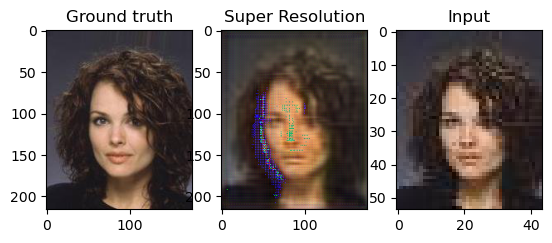

200
#########################Stats#####################
D_x :  0.9999991655349731  D_G_x :  8.754446753300726e-05  D_G_x_1 :  7.579031080240384e-05


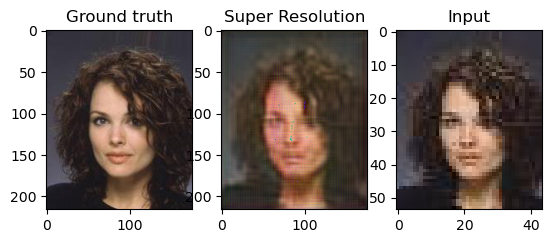

300
#########################Stats#####################
D_x :  0.999987006187439  D_G_x :  3.8059915823396295e-05  D_G_x_1 :  3.884365287376568e-05


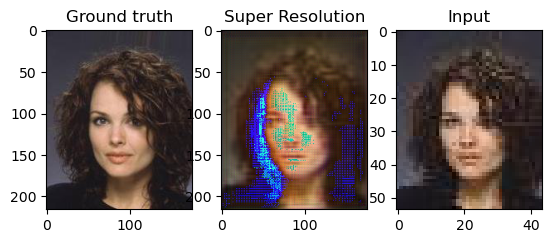

400
#########################Stats#####################
D_x :  1.0  D_G_x :  0.00022523631923832  D_G_x_1 :  0.00013885466614738107


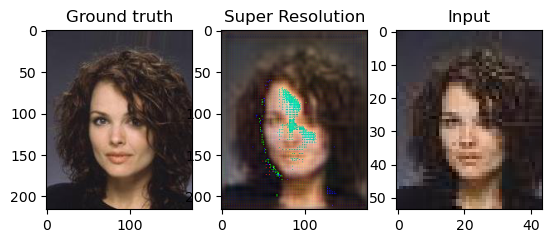

500
#########################Stats#####################
D_x :  0.9999995827674866  D_G_x :  0.012938891537487507  D_G_x_1 :  0.01215888001024723


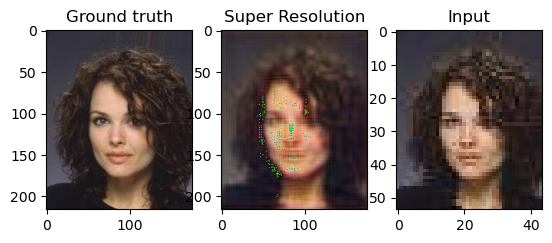

600
#########################Stats#####################
D_x :  0.9999986886978149  D_G_x :  0.0006074861739762127  D_G_x_1 :  9.999680332839489e-05


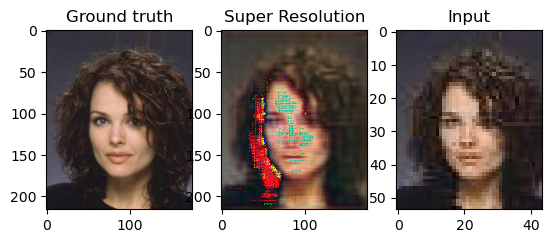

700
#########################Stats#####################
D_x :  0.9999550580978394  D_G_x :  4.0352037444790767e-07  D_G_x_1 :  9.579346169630298e-07


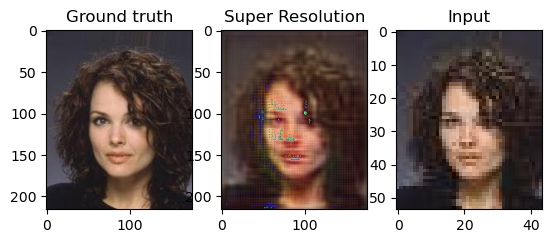

800
#########################Stats#####################
D_x :  0.9999998211860657  D_G_x :  0.08809585869312286  D_G_x_1 :  0.04290872812271118


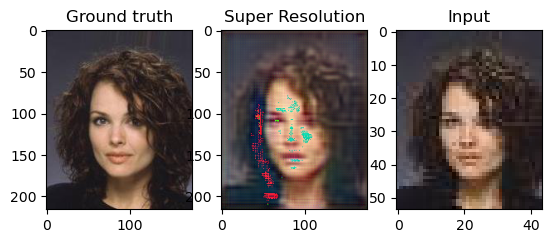

900
#########################Stats#####################
D_x :  1.0  D_G_x :  0.006706962827593088  D_G_x_1 :  0.00503025995567441


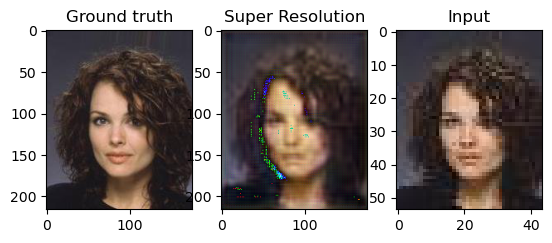

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  0.11248335242271423  D_G_x_1 :  0.0174102745950222


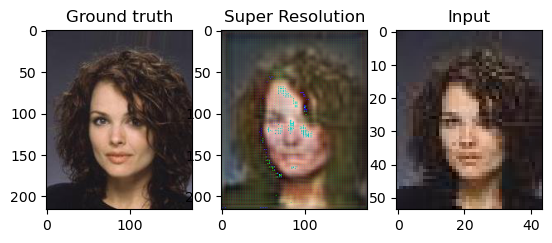

100
#########################Stats#####################
D_x :  1.0  D_G_x :  0.013938595540821552  D_G_x_1 :  0.007176924031227827


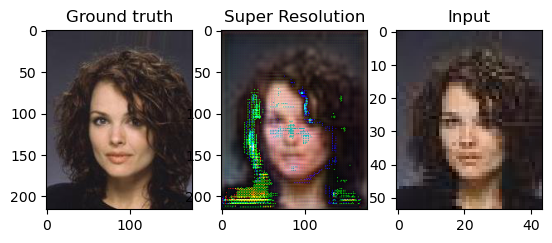

200
#########################Stats#####################
D_x :  0.9999977946281433  D_G_x :  0.2251669466495514  D_G_x_1 :  0.11668604612350464


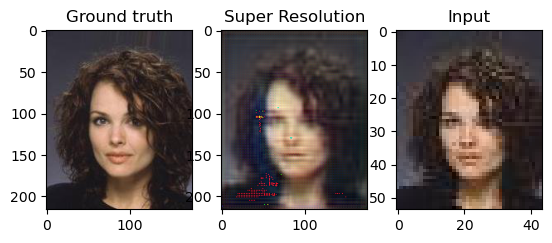

300
#########################Stats#####################
D_x :  1.0  D_G_x :  0.0021093925461173058  D_G_x_1 :  0.002174672205001116


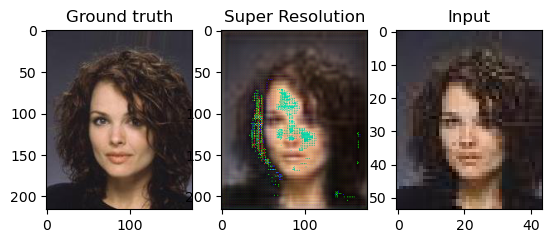

400
#########################Stats#####################
D_x :  0.9991529583930969  D_G_x :  0.00028244766872376204  D_G_x_1 :  0.0002858720254153013


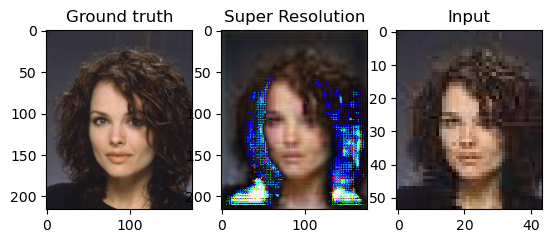

500
#########################Stats#####################
D_x :  0.9999999403953552  D_G_x :  2.2138270651339553e-05  D_G_x_1 :  2.3062511900207028e-05


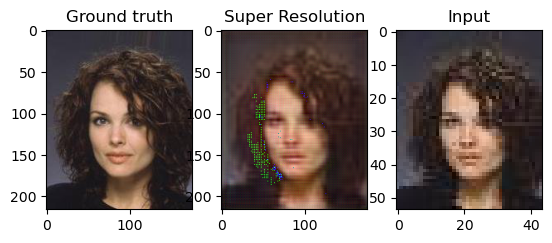

600
#########################Stats#####################
D_x :  0.9999997019767761  D_G_x :  0.00034979969495907426  D_G_x_1 :  0.00034103900543414056


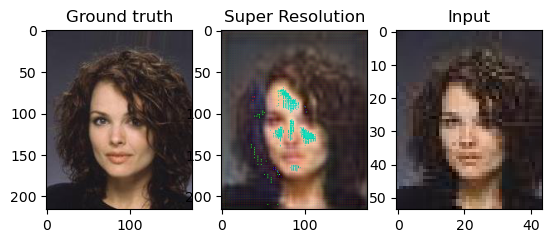

700
#########################Stats#####################
D_x :  1.0  D_G_x :  0.00017468942678533494  D_G_x_1 :  0.00017227941134478897


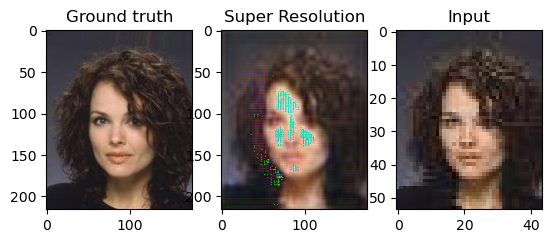

800
#########################Stats#####################
D_x :  1.0  D_G_x :  9.430390491615981e-05  D_G_x_1 :  9.377345850225538e-05


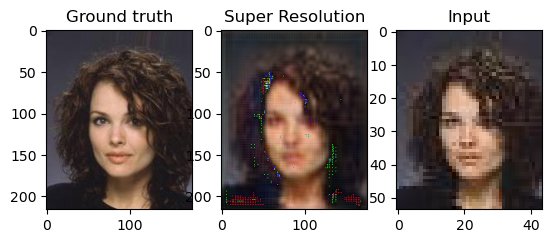

900
#########################Stats#####################
D_x :  1.0  D_G_x :  9.365432561025955e-06  D_G_x_1 :  9.172194040729664e-06


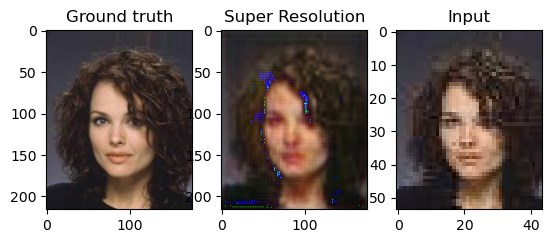

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  0.00011340998753439635  D_G_x_1 :  0.00011302622442599386


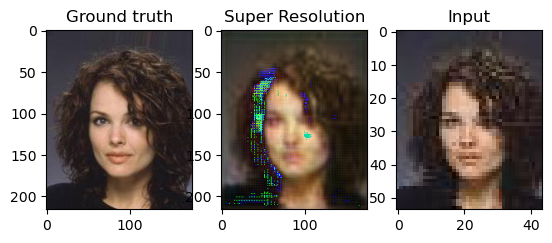

100
#########################Stats#####################
D_x :  1.0  D_G_x :  4.2905019654426724e-05  D_G_x_1 :  4.227950194035657e-05


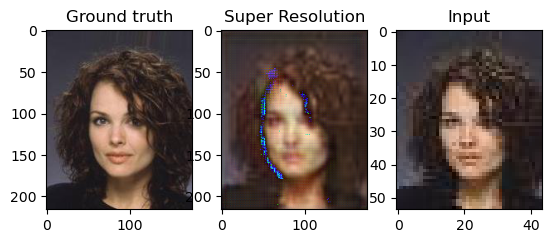

200
#########################Stats#####################
D_x :  0.9999999403953552  D_G_x :  0.0001037080364767462  D_G_x_1 :  0.00010361560998717323


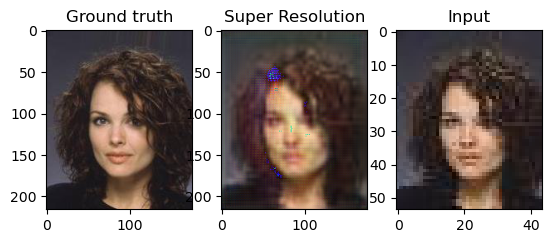

300
#########################Stats#####################
D_x :  1.0  D_G_x :  3.9768910937709734e-05  D_G_x_1 :  3.947144068661146e-05


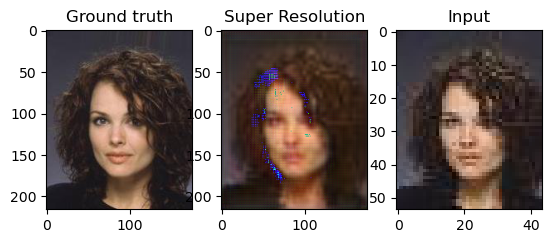

400
#########################Stats#####################
D_x :  1.0  D_G_x :  0.0010587547440081835  D_G_x_1 :  0.0006146397790871561


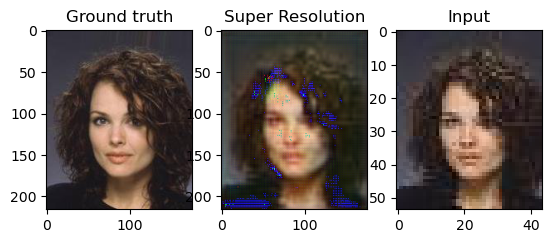

500
#########################Stats#####################
D_x :  1.0  D_G_x :  0.022699551656842232  D_G_x_1 :  0.03493497893214226


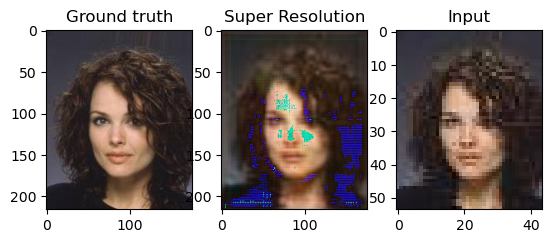

600
#########################Stats#####################
D_x :  0.9999961853027344  D_G_x :  3.973507318733027e-06  D_G_x_1 :  1.8407208699500188e-05


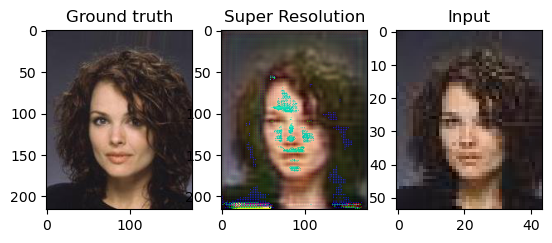

700
#########################Stats#####################
D_x :  1.0  D_G_x :  0.031064610928297043  D_G_x_1 :  0.01465627271682024


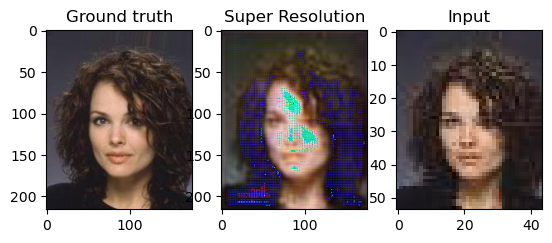

800
#########################Stats#####################
D_x :  1.0  D_G_x :  4.887357590632746e-06  D_G_x_1 :  4.972433089278638e-06


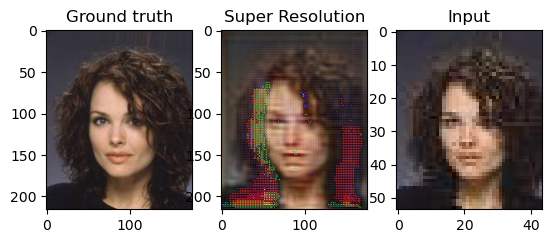

900
#########################Stats#####################
D_x :  0.9999820590019226  D_G_x :  2.0763114662258886e-05  D_G_x_1 :  1.6834103007568046e-05


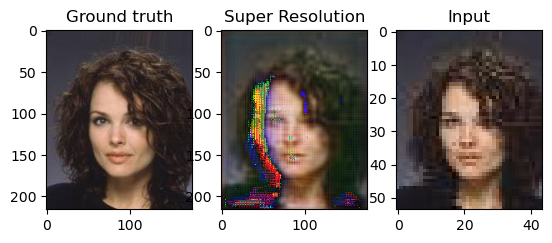

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  7.885505510785151e-06  D_G_x_1 :  1.188996702694567e-05


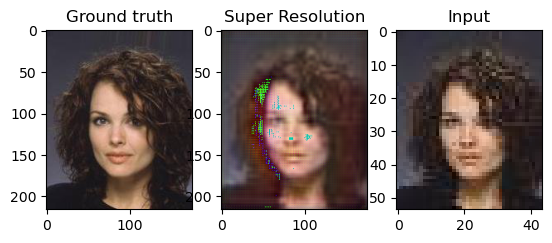

100
#########################Stats#####################
D_x :  1.0  D_G_x :  0.01444181241095066  D_G_x_1 :  0.01265680231153965


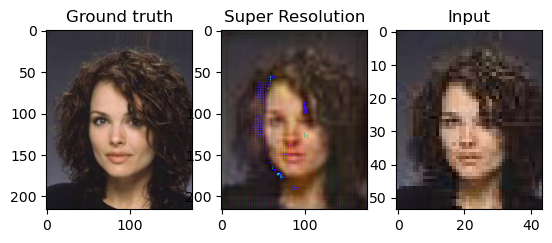

200
#########################Stats#####################
D_x :  1.0  D_G_x :  0.19830986857414246  D_G_x_1 :  0.03384920954704285


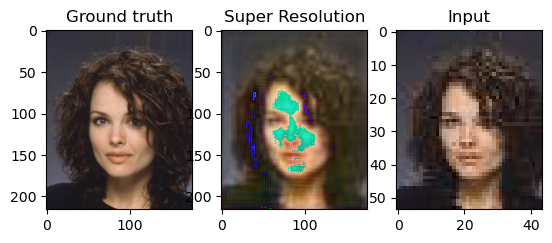

300
#########################Stats#####################
D_x :  1.0  D_G_x :  0.0008929422474466264  D_G_x_1 :  0.000827635230962187


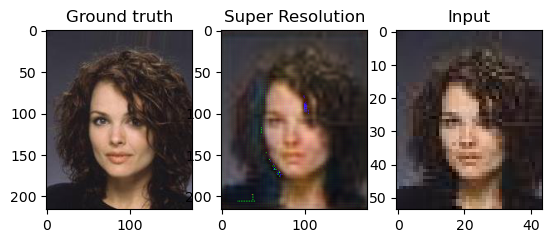

400
#########################Stats#####################
D_x :  0.9999982118606567  D_G_x :  1.5815371625649277e-06  D_G_x_1 :  1.5447026271431241e-06


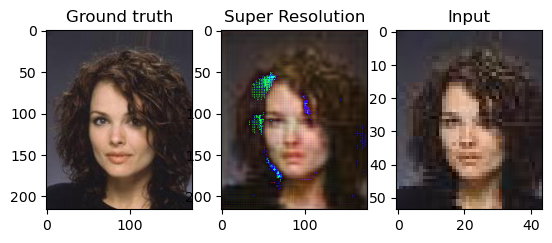

500
#########################Stats#####################
D_x :  1.0  D_G_x :  5.68108371226117e-05  D_G_x_1 :  5.7263398048235103e-05


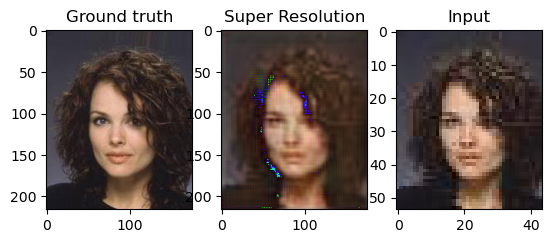

600
#########################Stats#####################
D_x :  0.9996961951255798  D_G_x :  2.909663635364268e-06  D_G_x_1 :  2.920587803600938e-06


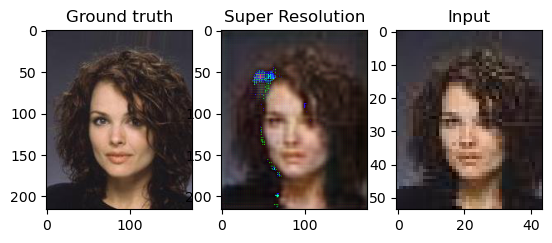

700
#########################Stats#####################
D_x :  1.0  D_G_x :  6.904049314471195e-07  D_G_x_1 :  5.762622663496586e-07


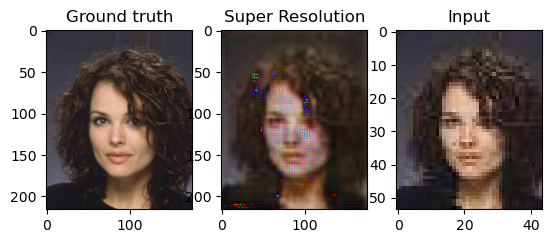

800
#########################Stats#####################
D_x :  1.0  D_G_x :  4.2910673073492944e-05  D_G_x_1 :  1.5636212992831133e-05


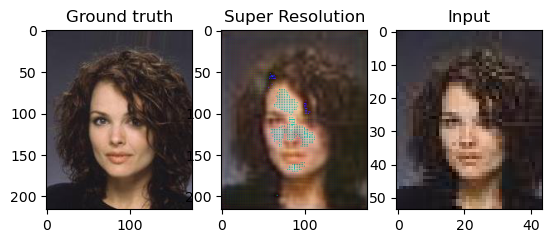

900
#########################Stats#####################
D_x :  0.6400953531265259  D_G_x :  0.0002208477962994948  D_G_x_1 :  0.0008327818941324949


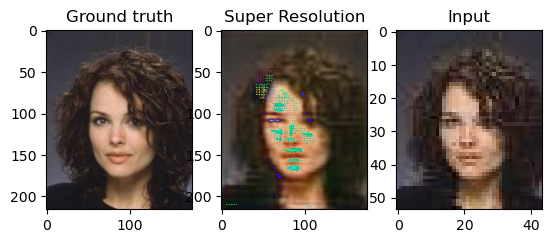

1000
#########################Stats#####################
D_x :  0.9999934434890747  D_G_x :  2.385464085818967e-06  D_G_x_1 :  1.6737297983127064e-06


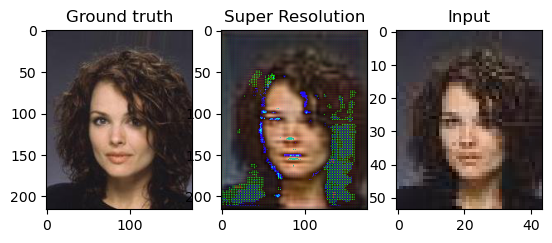

100
#########################Stats#####################
D_x :  1.0  D_G_x :  0.006160627119243145  D_G_x_1 :  0.005514815449714661


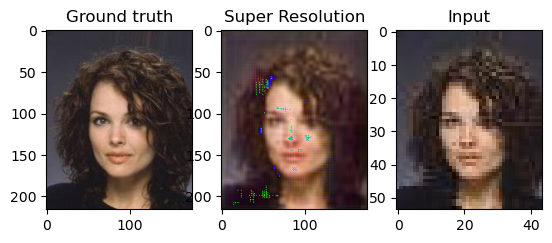

200
#########################Stats#####################
D_x :  1.0  D_G_x :  0.0008679832681082189  D_G_x_1 :  0.0007772747194394469


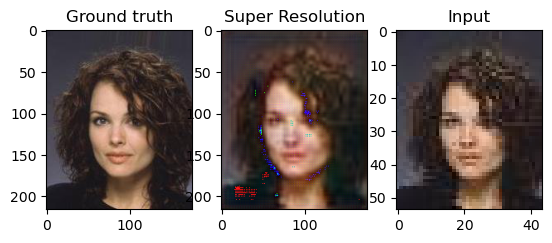

300
#########################Stats#####################
D_x :  0.9999996423721313  D_G_x :  2.140441601738985e-08  D_G_x_1 :  4.198984981940157e-08


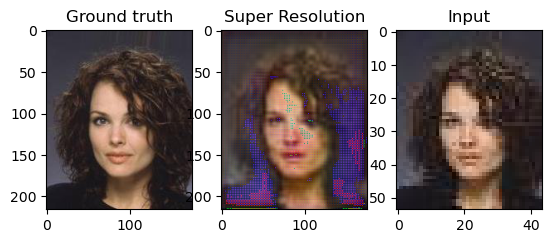

400
#########################Stats#####################
D_x :  0.9999999403953552  D_G_x :  9.453979873796925e-05  D_G_x_1 :  9.33617411646992e-05


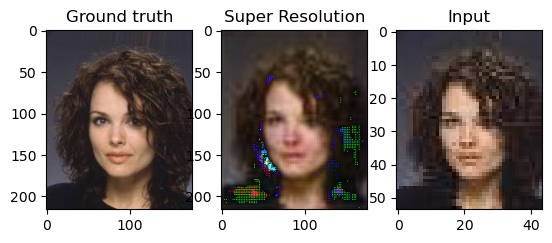

500
#########################Stats#####################
D_x :  0.9999768137931824  D_G_x :  8.742884347157087e-06  D_G_x_1 :  8.39866970636649e-06


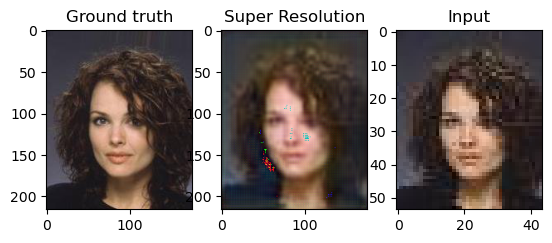

600
#########################Stats#####################
D_x :  1.0  D_G_x :  9.839375536557782e-09  D_G_x_1 :  1.3046887126222373e-08


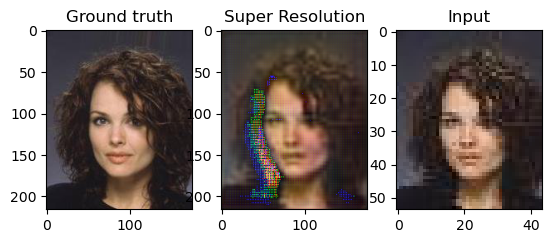

700
#########################Stats#####################
D_x :  1.0  D_G_x :  3.0276825782493688e-05  D_G_x_1 :  2.9573177016573027e-05


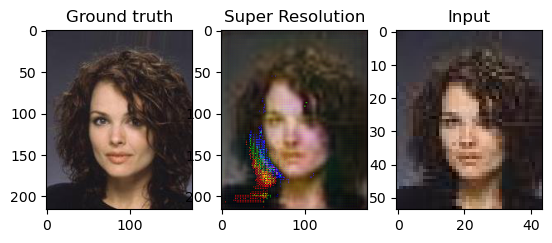

800
#########################Stats#####################
D_x :  0.9999988675117493  D_G_x :  0.0001262474397663027  D_G_x_1 :  0.0001218399265781045


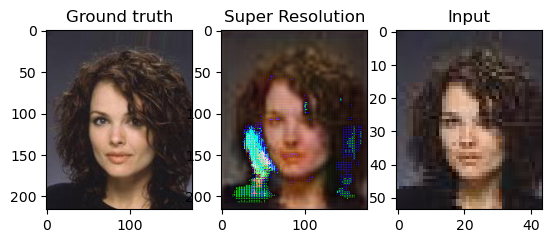

900
#########################Stats#####################
D_x :  1.0  D_G_x :  0.00014709850074723363  D_G_x_1 :  0.00014470083988271654


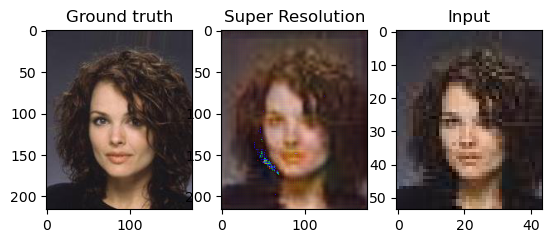

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  6.476635462604463e-05  D_G_x_1 :  6.950617535039783e-05


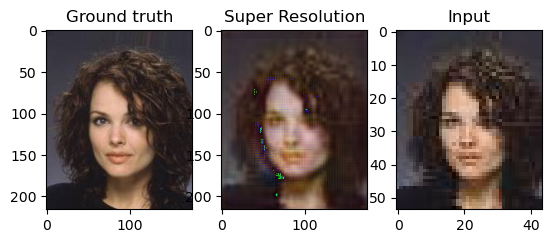

In [27]:
G_loss = []
D_loss = []

model_path = "../Codes/Models/"

for epoch in range(5):
    count = 0
    for sr_img, hr_img in train_loader:
               
        # Train the Discriminator
        
        Dis.zero_grad()
        
        sr_img = sr_img.cuda()
        hr_img = hr_img.cuda()
        
        out_D = Dis(hr_img)
        
        bsize = sr_img.size(0)
        label = torch.full((bsize,1), 1, device='cuda')
        label = label.float()
        # print(out_D.dtype,label.dtype)
        
        errD_real = loss_clf(out_D, label)
        
        errD_real.backward(retain_graph=True)
        D_x = out_D.mean().item()
        
        # Get the Fake images 
        
        fake = Gen(sr_img)
        
        out_D_G = Dis(fake)
        
        label = torch.full((bsize,1), 0, device='cuda')
        label = label.float()
        # print(out_D_G.dtype,label.dtype)

        errD_fake = loss_clf(out_D_G, label)
        
        errD_fake.backward(retain_graph=True)
        D_G_x = out_D_G.mean().item()
        
        errD = errD_fake + errD_real
        
        # Update Discriminator
        
        optimizerD.step()
        
        # Train the Generator
        
        Gen.zero_grad()
        
        errG = criterion(fake, hr_img)
        
        out_D_G_1 = Dis(fake)
        label = torch.full((bsize,1), 1, device='cuda')
        label = label.float()
        # print(out_D_G.dtype,label.dtype)
        e_g = loss_clf(out_D_G_1, label)
        D_G_1 = out_D_G_1.mean().item()
        
        errG = errG + 0.001* e_g # Check paper perceptual loss
        
        errG.backward(retain_graph=True)
        
        # Update the Generator
        
        optimizerG.step()
        
        count = count + 1
        
        if count%100 == 0:
            with torch.no_grad():
                
                print(count)
                
                print("#########################Stats#####################")
                
                print("D_x : ", D_x, " D_G_x : ", D_G_x, " D_G_x_1 : ", D_G_1)
                
                f, (ax1, ax2, ax3) = plt.subplots(1, 3)

                c = 0
                for sr, hr in val_loader:
                    if c == 0:
                        sr_rel = sr.cuda()
                        hr_rel = hr.cuda()
                        fk = Gen(sr_rel)
                    c = c + 1
                
                img = np.transpose(hr_rel.cpu().numpy()[0,:,:,:], (1, 2, 0))
                img = (img)*255
                img = img.astype(np.uint8)
                ax1.imshow(img)
                ax1.set_title('Ground truth')
                
                imgf = np.transpose(fk.cpu().numpy()[0,:,:,:], (1, 2, 0))
                imgf = (imgf)*255
                imgf = imgf.astype(np.uint8)
                ax2.imshow(imgf)
                ax2.set_title('Super Resolution')
                
                imgi = np.transpose(sr_rel.cpu().numpy()[0,:,:,:], (1, 2, 0))
                imgi = (imgi)*255
                imgi = imgi.astype(np.uint8)
                ax3.imshow(imgi)
                ax3.set_title('Input')
                
                plt.show()
    
    torch.save(Gen.state_dict(),model_path+'Gen_'+str(epoch)+'.pth')
    torch.save(Dis.state_dict(),model_path+'Dis_'+str(epoch)+'.pth')

In [28]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.convolution_layer_0 = nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = 9, stride = 1, padding = 4)
        self.prelu0 = nn.PReLU()
        self.rb_0 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_1 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_2 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_3 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.rb_4 =nn.Sequential(
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64),
            nn.PReLU(),
            nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1),
            nn.BatchNorm2d(64)
        )
        self.convolution_layer_1 = nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
        self.bn1 = nn.BatchNorm2d(64)
        
        self.convolution_layer_2 = nn.Conv2d(in_channels = 64, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
        self.trans_conv_1 = nn.ConvTranspose2d(in_channels=256, out_channels = 256, kernel_size = 3, padding = 1, stride =2)
        self.bn2 = nn.BatchNorm2d(256)
        self.prelu1 = nn.PReLU()

        self.convolution_layer_3 = nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
        self.trans_conv_0 = nn.ConvTranspose2d(in_channels=256, out_channels = 256, kernel_size = 3, padding = 1, stride =2)
        self.convolution_layer_4 = nn.Conv2d(in_channels = 256, out_channels = 3, kernel_size = 9, stride = 1, padding = 4)

        
    def forward(self, x):
        x = self.convolution_layer_0(x)
        x = self.prelu0(x)
        
        residual1 = x
        
        x = self.rb_0(x)
        x += residual1
        
        residual2 = x
        
        x = self.rb_1(x)
        
        x += residual2
        
        residual3 = x
        
        x = self.rb_2(x)
        
        x += residual3
        
        residual4 = x
        
        x = self.rb_3(x)
        
        x += residual4
        
        residual5 = x
        
        x = self.rb_4(x)
        
        x += residual5

        x = self.convolution_layer_1(x)
        x = self.bn1(x)
        
        x += residual1
        
        x = self.convolution_layer_2(x)
        
        x = self.trans_conv_1(x, output_size = [i * 2 for i in list((x.size()[2:4]))])
        x = self.bn2(x)
        x = self.prelu1(x)
        
        x = self.convolution_layer_3(x)
        x = self.trans_conv_0(x, output_size = [i * 2 for i in list((x.size()[2:4]))])
        
        x = self.convolution_layer_4(x)
        
        return x      

In [29]:
model_path = "../Codes/Models/"

Gen = Generator()
Dis = Discriminator()

model_dict = Gen.state_dict()

pre_train = torch.load(model_path+'Gen_4.pth')

model_dict.update(pre_train)        

Gen.load_state_dict(model_dict)
Dis.load_state_dict(torch.load(model_path+'Dis_4.pth'))

Gen = Gen.cuda()
Dis = Dis.cuda()

100
#########################Stats#####################
D_x :  1.0  D_G_x :  7.074383034932907e-08  D_G_x_1 :  7.074383034932907e-08  Error :  0.363393634557724


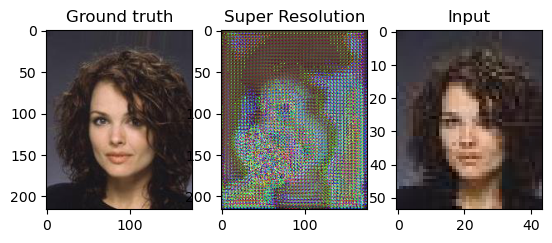

200
#########################Stats#####################
D_x :  1.0  D_G_x :  1.9837381515230845e-08  D_G_x_1 :  1.9837381515230845e-08  Error :  0.3963461220264435


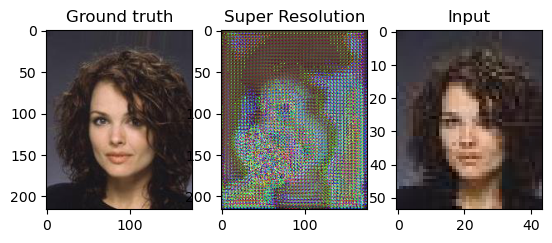

300
#########################Stats#####################
D_x :  0.9999998211860657  D_G_x :  2.5752719068350416e-08  D_G_x_1 :  2.5752719068350416e-08  Error :  0.3886948525905609


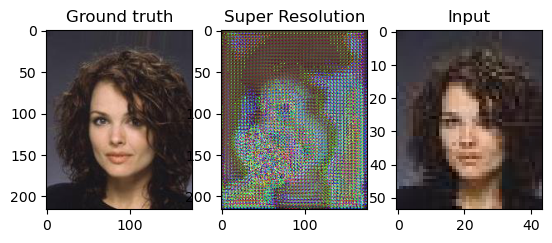

400
#########################Stats#####################
D_x :  1.0  D_G_x :  1.5521342433544305e-08  D_G_x_1 :  1.5521342433544305e-08  Error :  0.3715682029724121


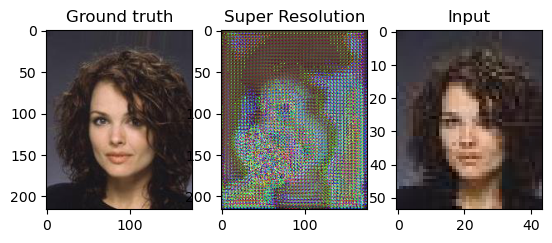

500
#########################Stats#####################
D_x :  1.0  D_G_x :  4.475509740586858e-08  D_G_x_1 :  4.475509740586858e-08  Error :  0.4074135720729828


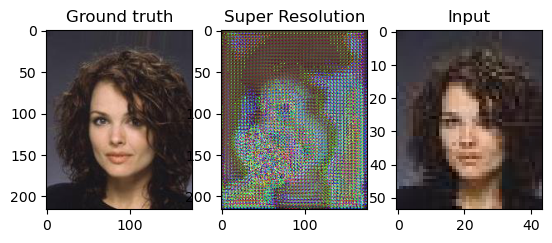

600
#########################Stats#####################
D_x :  0.9999972581863403  D_G_x :  9.116078558690788e-09  D_G_x_1 :  9.116078558690788e-09  Error :  0.3861188590526581


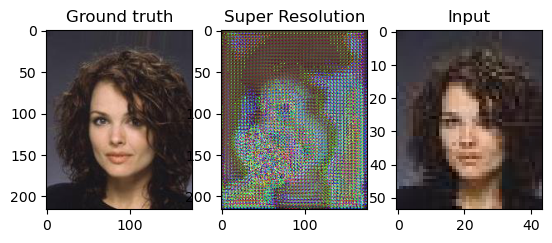

700
#########################Stats#####################
D_x :  1.0  D_G_x :  2.965797385456881e-09  D_G_x_1 :  2.965797385456881e-09  Error :  0.3528560400009155


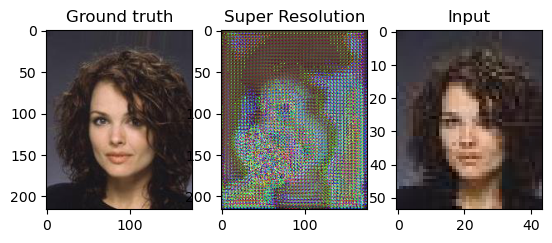

800
#########################Stats#####################
D_x :  1.0  D_G_x :  1.1426370960521126e-09  D_G_x_1 :  1.1426370960521126e-09  Error :  0.38796401023864746


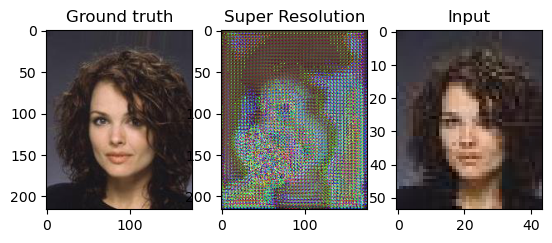

900
#########################Stats#####################
D_x :  1.0  D_G_x :  2.607705340551547e-08  D_G_x_1 :  2.607705340551547e-08  Error :  0.3870789706707001


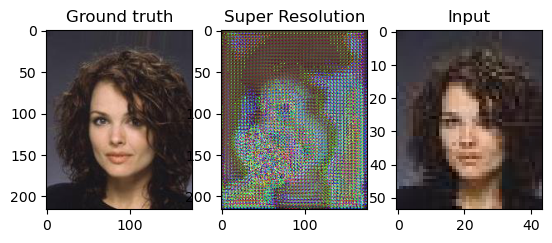

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  1.3818864275094711e-08  D_G_x_1 :  1.3818864275094711e-08  Error :  0.3953832685947418


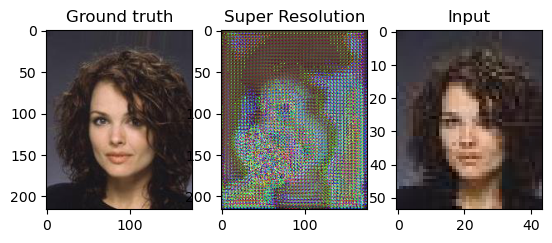

100
#########################Stats#####################
D_x :  1.0  D_G_x :  5.445142114979262e-09  D_G_x_1 :  5.445142114979262e-09  Error :  0.3818322420120239


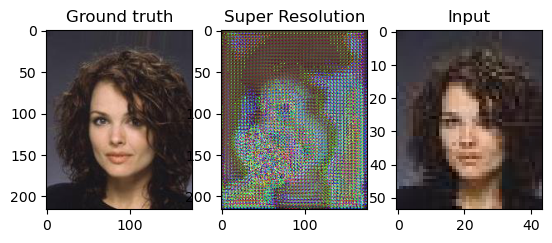

200
#########################Stats#####################
D_x :  1.0  D_G_x :  2.3447935149079058e-08  D_G_x_1 :  2.3447935149079058e-08  Error :  0.3721311688423157


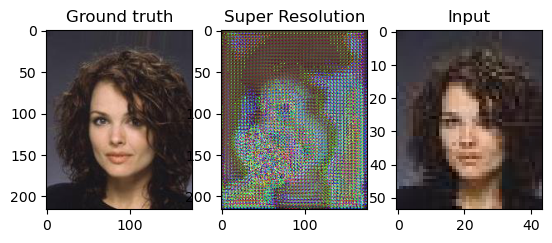

300
#########################Stats#####################
D_x :  1.0  D_G_x :  8.208986379543148e-09  D_G_x_1 :  8.208986379543148e-09  Error :  0.36008328199386597


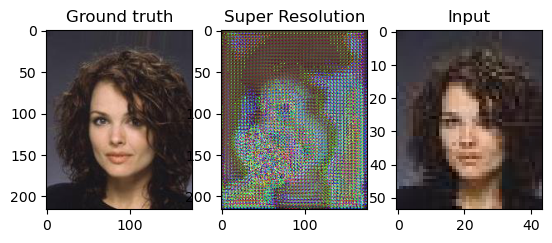

400
#########################Stats#####################
D_x :  0.9962273240089417  D_G_x :  3.09125738340299e-07  D_G_x_1 :  3.09125738340299e-07  Error :  0.39179500937461853


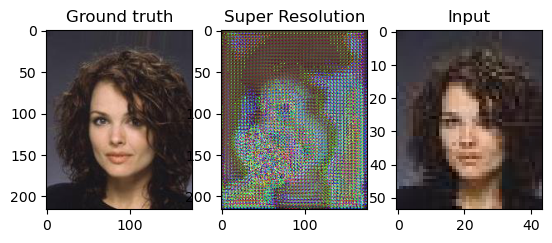

500
#########################Stats#####################
D_x :  0.9999997019767761  D_G_x :  7.278053999471013e-07  D_G_x_1 :  7.278053999471013e-07  Error :  0.40400922298431396


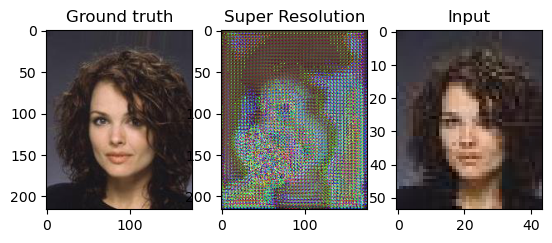

600
#########################Stats#####################
D_x :  1.0  D_G_x :  1.1261121812822239e-07  D_G_x_1 :  1.1261121812822239e-07  Error :  0.3673058748245239


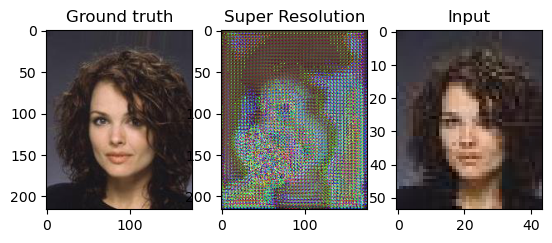

700
#########################Stats#####################
D_x :  1.0  D_G_x :  2.7121858536816035e-08  D_G_x_1 :  2.7121858536816035e-08  Error :  0.3856516182422638


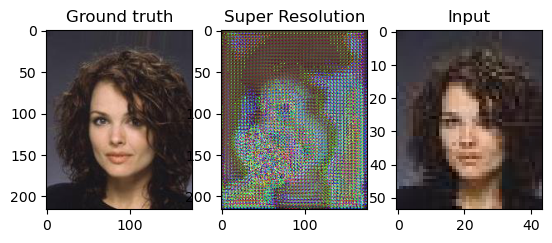

800
#########################Stats#####################
D_x :  1.0  D_G_x :  3.15480502832699e-10  D_G_x_1 :  3.15480502832699e-10  Error :  0.37689751386642456


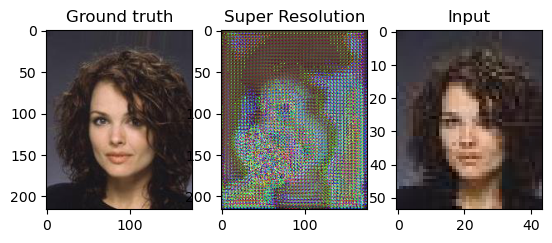

900
#########################Stats#####################
D_x :  1.0  D_G_x :  2.575025082052207e-09  D_G_x_1 :  2.575025082052207e-09  Error :  0.43310827016830444


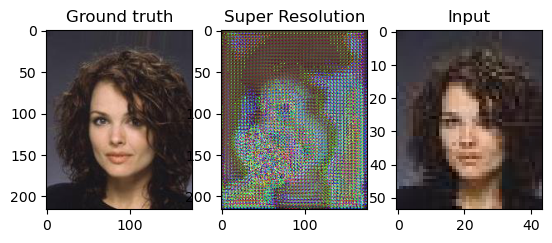

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  1.2224581347197727e-09  D_G_x_1 :  1.2224581347197727e-09  Error :  0.38189682364463806


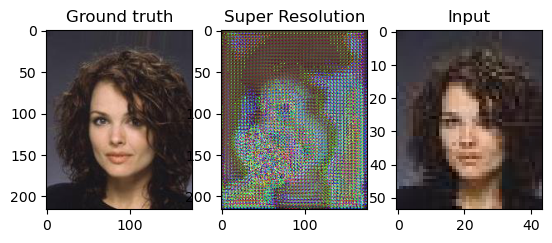

100
#########################Stats#####################
D_x :  1.0  D_G_x :  1.465910628439815e-07  D_G_x_1 :  1.465910628439815e-07  Error :  0.4166349768638611


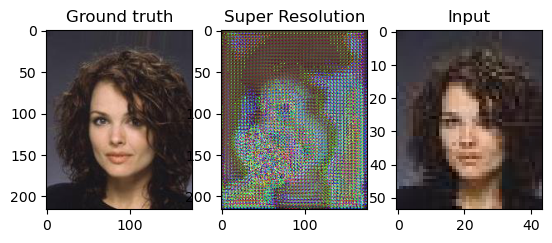

200
#########################Stats#####################
D_x :  1.0  D_G_x :  3.3136946520073707e-09  D_G_x_1 :  3.3136946520073707e-09  Error :  0.4102250337600708


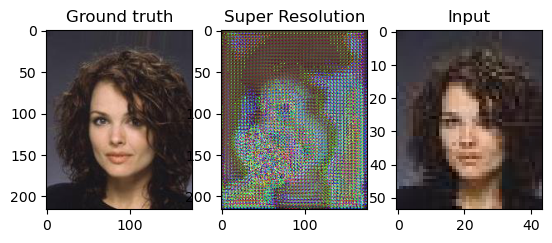

300
#########################Stats#####################
D_x :  0.9999658465385437  D_G_x :  2.619082284383012e-09  D_G_x_1 :  2.619082284383012e-09  Error :  0.40452903509140015


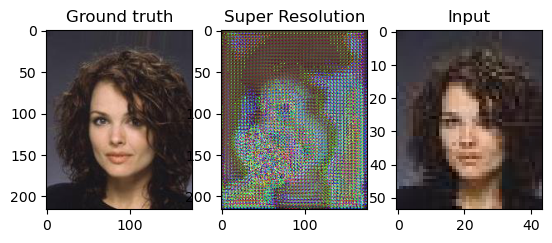

400
#########################Stats#####################
D_x :  1.0  D_G_x :  1.6157162718855034e-08  D_G_x_1 :  1.6157162718855034e-08  Error :  0.4029323160648346


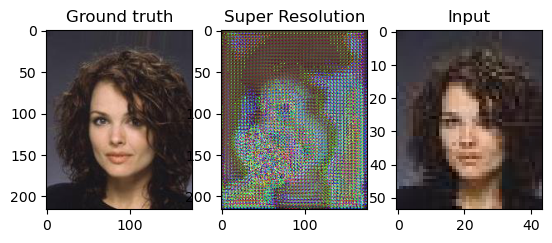

500
#########################Stats#####################
D_x :  1.0  D_G_x :  5.459114049699565e-09  D_G_x_1 :  5.459114049699565e-09  Error :  0.4131675362586975


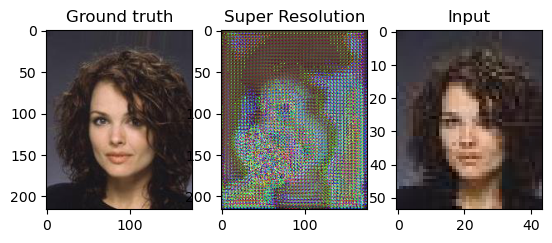

600
#########################Stats#####################
D_x :  1.0  D_G_x :  6.129690088840789e-09  D_G_x_1 :  6.129690088840789e-09  Error :  0.45602720975875854


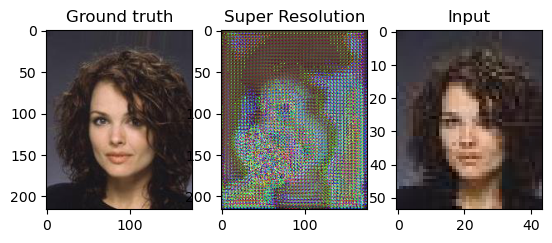

700
#########################Stats#####################
D_x :  1.0  D_G_x :  4.5481240995570715e-09  D_G_x_1 :  4.5481240995570715e-09  Error :  0.3850940465927124


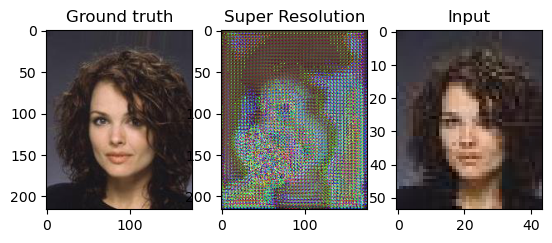

800
#########################Stats#####################
D_x :  1.0  D_G_x :  1.172505870172813e-09  D_G_x_1 :  1.172505870172813e-09  Error :  0.3791297972202301


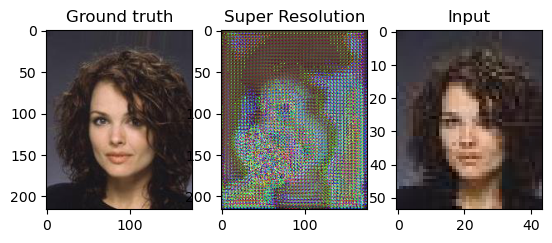

900
#########################Stats#####################
D_x :  0.9999985694885254  D_G_x :  5.7153934918119376e-09  D_G_x_1 :  5.7153934918119376e-09  Error :  0.3742731809616089


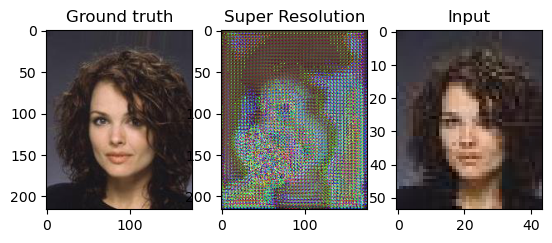

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  2.516794272988676e-10  D_G_x_1 :  2.516794272988676e-10  Error :  0.37080174684524536


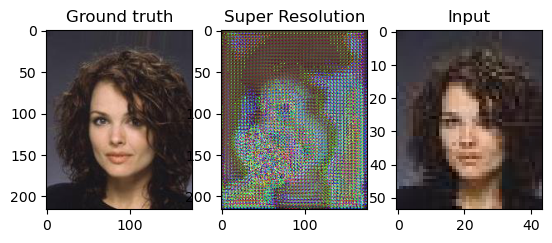

100
#########################Stats#####################
D_x :  0.9999997615814209  D_G_x :  1.9141091911478725e-07  D_G_x_1 :  1.9141091911478725e-07  Error :  0.4181855618953705


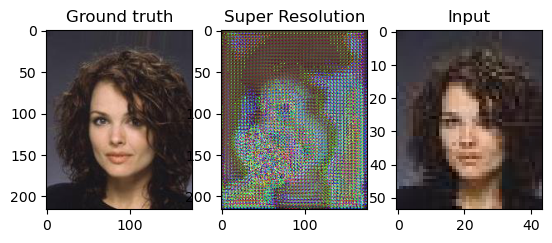

200
#########################Stats#####################
D_x :  1.0  D_G_x :  2.6531711938559965e-08  D_G_x_1 :  2.6531711938559965e-08  Error :  0.37403321266174316


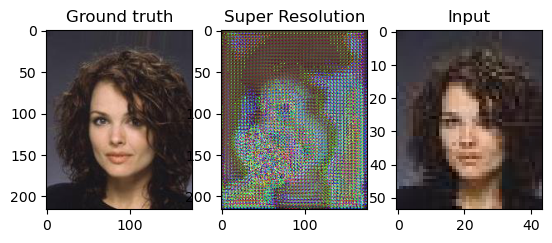

300
#########################Stats#####################
D_x :  1.0  D_G_x :  1.9362275338608015e-08  D_G_x_1 :  1.9362275338608015e-08  Error :  0.369046688079834


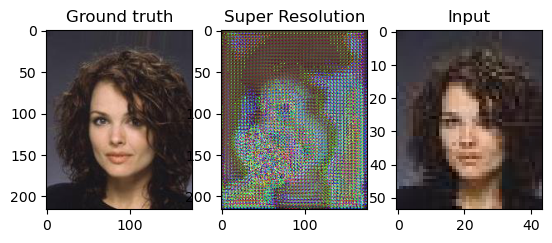

400
#########################Stats#####################
D_x :  0.9999966025352478  D_G_x :  1.1331641180944985e-09  D_G_x_1 :  1.1331641180944985e-09  Error :  0.38954958319664


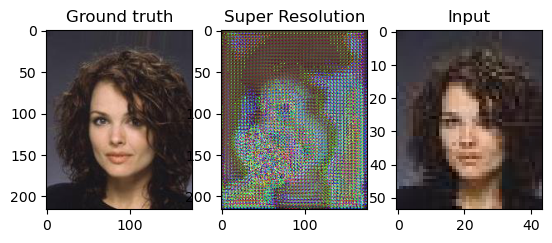

500
#########################Stats#####################
D_x :  0.9999615550041199  D_G_x :  4.7650722478920216e-08  D_G_x_1 :  4.7650722478920216e-08  Error :  0.44780001044273376


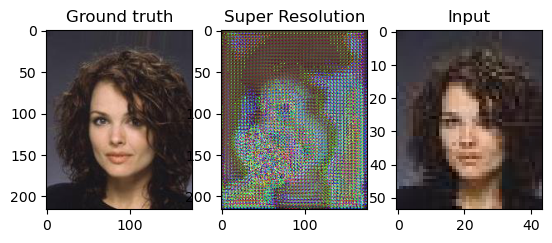

600
#########################Stats#####################
D_x :  0.9999827146530151  D_G_x :  4.245873697072966e-08  D_G_x_1 :  4.245873697072966e-08  Error :  0.39621880650520325


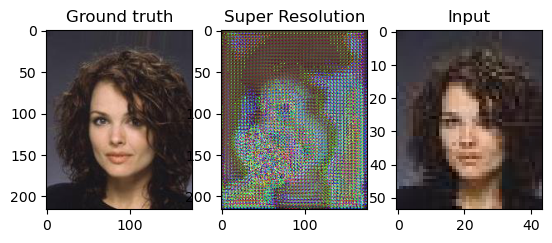

700
#########################Stats#####################
D_x :  0.9999938607215881  D_G_x :  1.7667900920059765e-07  D_G_x_1 :  1.7667900920059765e-07  Error :  0.40280529856681824


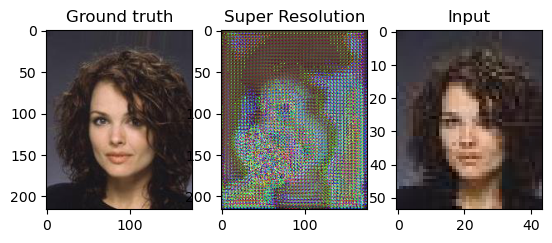

800
#########################Stats#####################
D_x :  1.0  D_G_x :  9.283908752877323e-08  D_G_x_1 :  9.283908752877323e-08  Error :  0.39811578392982483


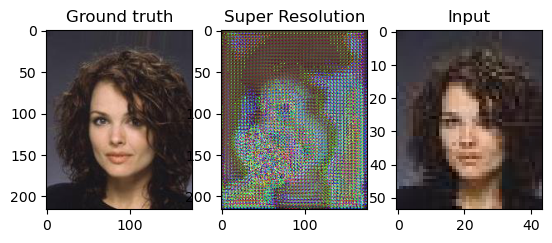

900
#########################Stats#####################
D_x :  0.999999463558197  D_G_x :  7.258478973426463e-08  D_G_x_1 :  7.258478973426463e-08  Error :  0.43956783413887024


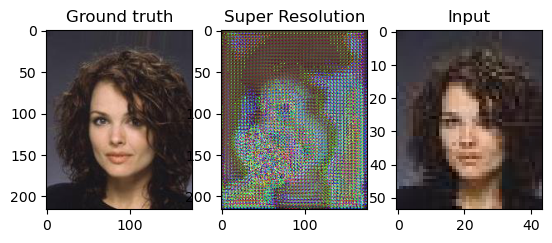

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  3.528580805323145e-08  D_G_x_1 :  3.528580805323145e-08  Error :  0.3539125621318817


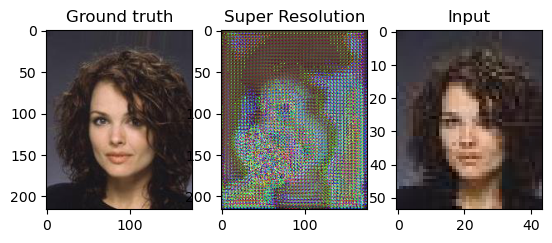

100
#########################Stats#####################
D_x :  1.0  D_G_x :  2.5100320044657565e-08  D_G_x_1 :  2.5100320044657565e-08  Error :  0.3660831153392792


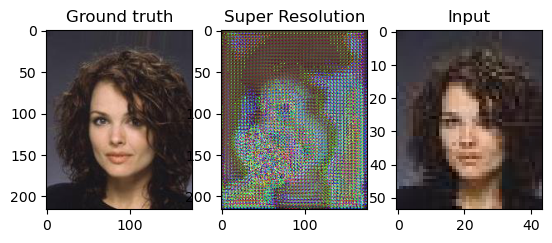

200
#########################Stats#####################
D_x :  1.0  D_G_x :  7.458496043000196e-10  D_G_x_1 :  7.458496043000196e-10  Error :  0.3575414717197418


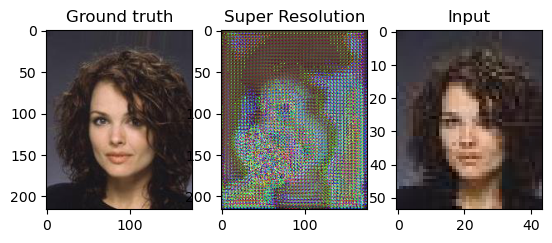

300
#########################Stats#####################
D_x :  1.0  D_G_x :  7.428592463387673e-11  D_G_x_1 :  7.428592463387673e-11  Error :  0.3877819776535034


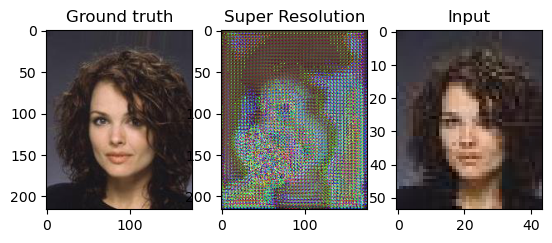

400
#########################Stats#####################
D_x :  1.0  D_G_x :  1.2105912716720013e-08  D_G_x_1 :  1.2105912716720013e-08  Error :  0.3722004294395447


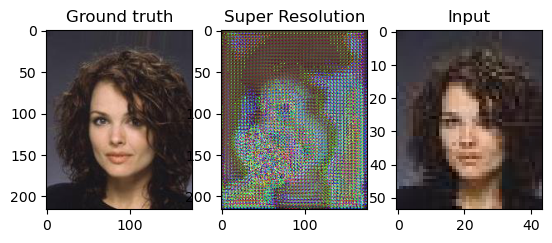

500
#########################Stats#####################
D_x :  1.0  D_G_x :  4.864335045873247e-10  D_G_x_1 :  4.864335045873247e-10  Error :  0.3792743980884552


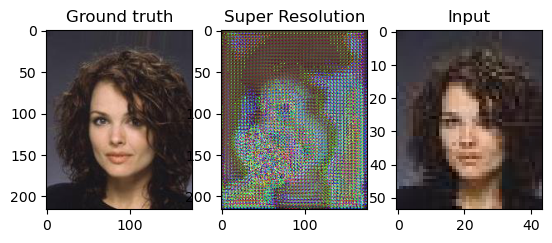

600
#########################Stats#####################
D_x :  1.0  D_G_x :  3.444340279656899e-07  D_G_x_1 :  3.444340279656899e-07  Error :  0.4258969724178314


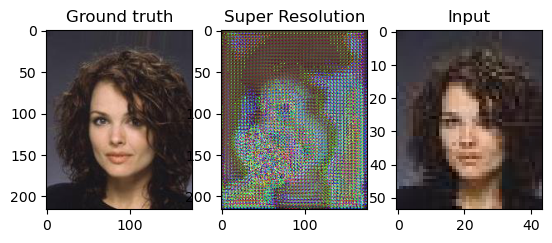

700
#########################Stats#####################
D_x :  1.0  D_G_x :  1.866078180867703e-09  D_G_x_1 :  1.866078180867703e-09  Error :  0.3883660137653351


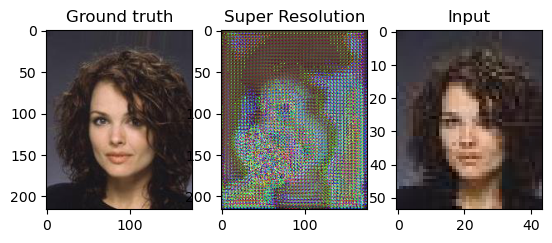

800
#########################Stats#####################
D_x :  1.0  D_G_x :  2.411763011522794e-10  D_G_x_1 :  2.411763011522794e-10  Error :  0.3640996515750885


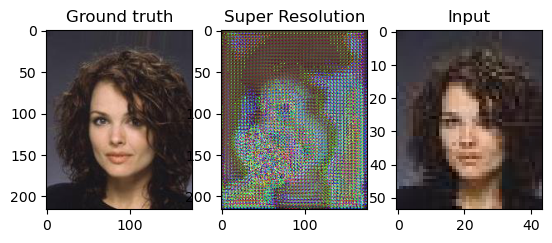

900
#########################Stats#####################
D_x :  1.0  D_G_x :  4.270165300113149e-05  D_G_x_1 :  4.270165300113149e-05  Error :  0.4299660921096802


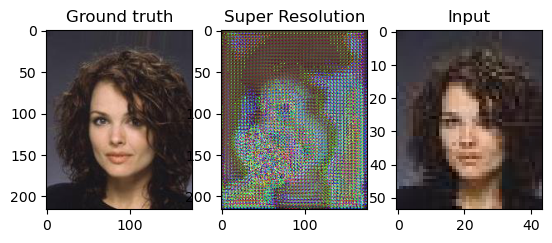

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  3.422973904321225e-09  D_G_x_1 :  3.422973904321225e-09  Error :  0.4240388870239258


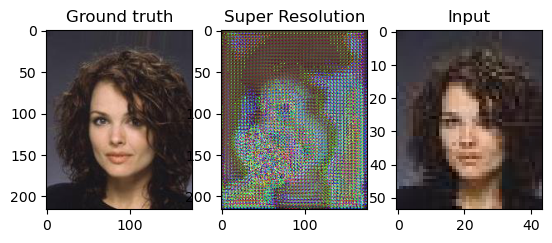

In [30]:
for epoch in range(5,10):
    count = 0
    for sr_img, hr_img in train_loader:
               
        # Train the Discriminator
        
        Dis.zero_grad()
        
        sr_img = sr_img.cuda()
        hr_img = hr_img.cuda()
        
        out_D = Dis(hr_img)
        
        bsize = sr_img.size(0)
        label = torch.full((bsize,1), 1, device='cuda')
        label = label.float()
        
        errD_real = loss_clf(out_D, label)
        
        errD_real.backward(retain_graph=True)
        D_x = out_D.mean().item()
        
        # Get the Fake images 
        
        fake = Gen(sr_img)
        
        out_D_G = Dis(fake)
        
        label = torch.full((bsize,1), 0, device='cuda')
        label = label.float()

        errD_fake = loss_clf(out_D_G, label)
        
        errD_fake.backward(retain_graph=True)
        D_G_x = out_D_G.mean().item()
        
        errD = errD_fake + errD_real
        
        # Update Discriminator
        
        optimizerD.step()
        
        # Train the Generator
        
        Gen.zero_grad()
        
        errG = criterion(fake, hr_img)
        
        out_D_G_1 = Dis(fake)
        label = torch.full((bsize,1), 1, device='cuda')
        label = label.float()
        e_g = loss_clf(out_D_G_1, label)
        D_G_1 = out_D_G_1.mean().item()
        
        errG = errG + 0.001*e_g # Check paper perceptual loss
        
        errG.backward(retain_graph=True)
        
        # Update the Generator
        
        optimizerG.step()
        
        count = count + 1
        
        if count%100 == 0:
            with torch.no_grad():
                
                print(count)
                
                print("#########################Stats#####################")
                
                print("D_x : ", D_x, " D_G_x : ", D_G_x, " D_G_x_1 : ", D_G_1, " Error : ", errG.item())
                
                f, (ax1, ax2, ax3) = plt.subplots(1, 3)

                c = 0
                for sr, hr in val_loader:
                    if c == 0:
                        sr_rel = sr.cuda()
                        hr_rel = hr.cuda()
                        fk = Gen(sr_rel)
                    c = c + 1
                
                img = np.transpose(hr_rel.cpu().numpy()[0,:,:,:], (1, 2, 0))
                img = (img)*255
                img = img.astype(np.uint8)
                ax1.imshow(img)
                ax1.set_title('Ground truth')
                
                imgf = np.transpose(fk.cpu().numpy()[0,:,:,:], (1, 2, 0))
                imgf = (imgf)*255
                imgf = imgf.astype(np.uint8)
                ax2.imshow(imgf)
                ax2.set_title('Super Resolution')
                
                imgi = np.transpose(sr_rel.cpu().numpy()[0,:,:,:], (1, 2, 0))
                imgi = (imgi)*255
                imgi = imgi.astype(np.uint8)
                ax3.imshow(imgi)
                ax3.set_title('Input')
                
                plt.show()
    
    torch.save(Gen.state_dict(),model_path+'Gen_'+str(epoch)+'.pth')
    torch.save(Dis.state_dict(),model_path+'Dis_'+str(epoch)+'.pth')

In [31]:
import torchvision.models as models

In [32]:
vgg = models.vgg19(pretrained=True)

/home/ml/anaconda3/envs/DL_p/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/home/ml/anaconda3/envs/DL_p/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /home/ml/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100.0%


In [33]:
vgg = vgg.cuda()
summary(vgg,ex[1].shape)

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 512, 6, 5]           --
|    └─Conv2d: 2-1                       [-1, 64, 216, 176]        1,792
|    └─ReLU: 2-2                         [-1, 64, 216, 176]        --
|    └─Conv2d: 2-3                       [-1, 64, 216, 176]        36,928
|    └─ReLU: 2-4                         [-1, 64, 216, 176]        --
|    └─MaxPool2d: 2-5                    [-1, 64, 108, 88]         --
|    └─Conv2d: 2-6                       [-1, 128, 108, 88]        73,856
|    └─ReLU: 2-7                         [-1, 128, 108, 88]        --
|    └─Conv2d: 2-8                       [-1, 128, 108, 88]        147,584
|    └─ReLU: 2-9                         [-1, 128, 108, 88]        --
|    └─MaxPool2d: 2-10                   [-1, 128, 54, 44]         --
|    └─Conv2d: 2-11                      [-1, 256, 54, 44]         295,168
|    └─ReLU: 2-12                        [-1, 256, 54, 44]      

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 512, 6, 5]           --
|    └─Conv2d: 2-1                       [-1, 64, 216, 176]        1,792
|    └─ReLU: 2-2                         [-1, 64, 216, 176]        --
|    └─Conv2d: 2-3                       [-1, 64, 216, 176]        36,928
|    └─ReLU: 2-4                         [-1, 64, 216, 176]        --
|    └─MaxPool2d: 2-5                    [-1, 64, 108, 88]         --
|    └─Conv2d: 2-6                       [-1, 128, 108, 88]        73,856
|    └─ReLU: 2-7                         [-1, 128, 108, 88]        --
|    └─Conv2d: 2-8                       [-1, 128, 108, 88]        147,584
|    └─ReLU: 2-9                         [-1, 128, 108, 88]        --
|    └─MaxPool2d: 2-10                   [-1, 128, 54, 44]         --
|    └─Conv2d: 2-11                      [-1, 256, 54, 44]         295,168
|    └─ReLU: 2-12                        [-1, 256, 54, 44]      

In [34]:
class Identity(torch.nn.Module):
    def __init__(self):
        super(Identity, self).__init__()
        
    def forward(self, x):
        return x

In [35]:
vgg.classifier = Identity()

summary(vgg,ex[1].shape)

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 512, 6, 5]           --
|    └─Conv2d: 2-1                       [-1, 64, 216, 176]        1,792
|    └─ReLU: 2-2                         [-1, 64, 216, 176]        --
|    └─Conv2d: 2-3                       [-1, 64, 216, 176]        36,928
|    └─ReLU: 2-4                         [-1, 64, 216, 176]        --
|    └─MaxPool2d: 2-5                    [-1, 64, 108, 88]         --
|    └─Conv2d: 2-6                       [-1, 128, 108, 88]        73,856
|    └─ReLU: 2-7                         [-1, 128, 108, 88]        --
|    └─Conv2d: 2-8                       [-1, 128, 108, 88]        147,584
|    └─ReLU: 2-9                         [-1, 128, 108, 88]        --
|    └─MaxPool2d: 2-10                   [-1, 128, 54, 44]         --
|    └─Conv2d: 2-11                      [-1, 256, 54, 44]         295,168
|    └─ReLU: 2-12                        [-1, 256, 54, 44]      

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 512, 6, 5]           --
|    └─Conv2d: 2-1                       [-1, 64, 216, 176]        1,792
|    └─ReLU: 2-2                         [-1, 64, 216, 176]        --
|    └─Conv2d: 2-3                       [-1, 64, 216, 176]        36,928
|    └─ReLU: 2-4                         [-1, 64, 216, 176]        --
|    └─MaxPool2d: 2-5                    [-1, 64, 108, 88]         --
|    └─Conv2d: 2-6                       [-1, 128, 108, 88]        73,856
|    └─ReLU: 2-7                         [-1, 128, 108, 88]        --
|    └─Conv2d: 2-8                       [-1, 128, 108, 88]        147,584
|    └─ReLU: 2-9                         [-1, 128, 108, 88]        --
|    └─MaxPool2d: 2-10                   [-1, 128, 54, 44]         --
|    └─Conv2d: 2-11                      [-1, 256, 54, 44]         295,168
|    └─ReLU: 2-12                        [-1, 256, 54, 44]      

In [36]:
model_path = "../Codes/Models/"

Gen = Generator()

Gen.load_state_dict(torch.load(model_path+'Gen_9.pth'))
Dis.load_state_dict(torch.load(model_path+'Dis_9.pth'))

Gen = Gen.cuda()
Dis = Dis.cuda()

100
#########################Stats#####################
D_x :  0.9999976754188538  D_G_x :  1.1774932140440342e-09  D_G_x_1 :  1.1774932140440342e-09  Error :  145.91444396972656


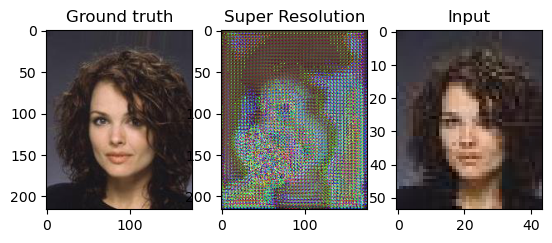

200
#########################Stats#####################
D_x :  1.0  D_G_x :  6.787583384237905e-09  D_G_x_1 :  6.787583384237905e-09  Error :  130.90093994140625


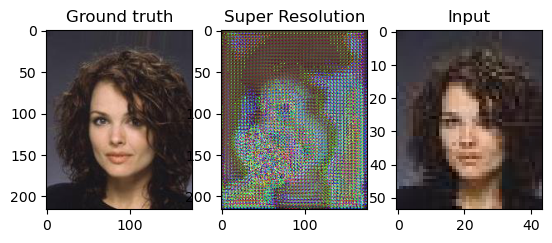

300
#########################Stats#####################
D_x :  1.0  D_G_x :  1.2885517097771526e-09  D_G_x_1 :  1.2885517097771526e-09  Error :  151.6622772216797


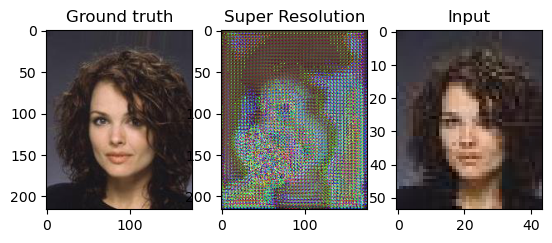

400
#########################Stats#####################
D_x :  1.0  D_G_x :  2.0627751950996753e-08  D_G_x_1 :  2.0627751950996753e-08  Error :  164.53927612304688


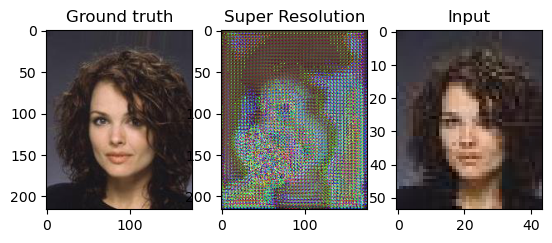

500
#########################Stats#####################
D_x :  1.0  D_G_x :  2.3171244478703557e-08  D_G_x_1 :  2.3171244478703557e-08  Error :  137.86175537109375


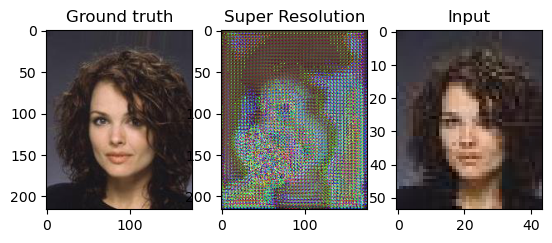

600
#########################Stats#####################
D_x :  1.0  D_G_x :  9.972676018321636e-09  D_G_x_1 :  9.972676018321636e-09  Error :  142.268798828125


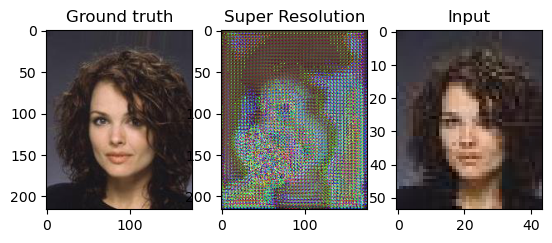

700
#########################Stats#####################
D_x :  0.9999998211860657  D_G_x :  3.6611752518567187e-10  D_G_x_1 :  3.6611752518567187e-10  Error :  147.23561096191406


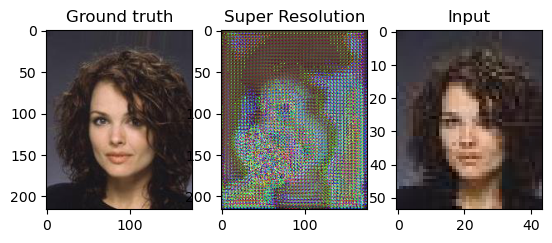

800
#########################Stats#####################
D_x :  0.9999796748161316  D_G_x :  1.6636563771044166e-07  D_G_x_1 :  1.6636563771044166e-07  Error :  148.23492431640625


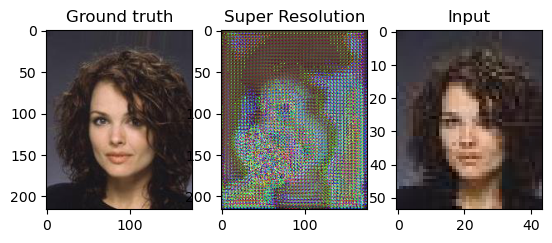

900
#########################Stats#####################
D_x :  0.999735951423645  D_G_x :  1.0873418432311155e-06  D_G_x_1 :  1.0873418432311155e-06  Error :  142.3511505126953


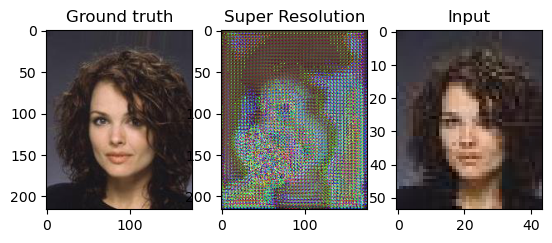

1000
#########################Stats#####################
D_x :  0.9999998211860657  D_G_x :  9.939647327428247e-09  D_G_x_1 :  9.939647327428247e-09  Error :  149.4429931640625


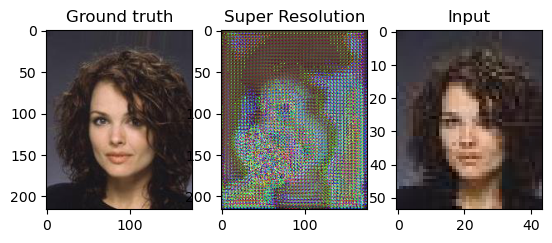

100
#########################Stats#####################
D_x :  1.0  D_G_x :  2.793822204694152e-07  D_G_x_1 :  2.793822204694152e-07  Error :  137.905029296875


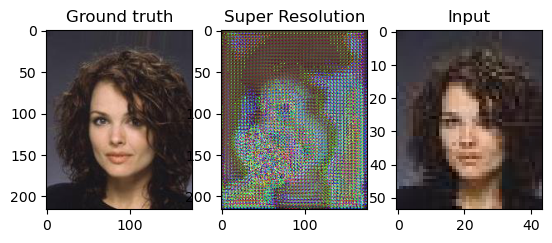

200
#########################Stats#####################
D_x :  1.0  D_G_x :  2.1188036214425665e-08  D_G_x_1 :  2.1188036214425665e-08  Error :  136.1616973876953


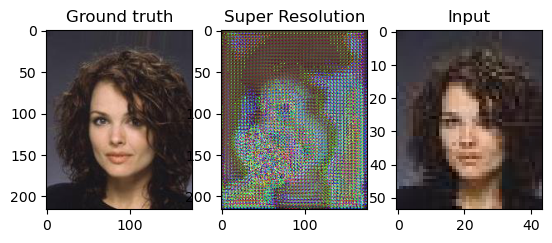

300
#########################Stats#####################
D_x :  1.0  D_G_x :  6.190040147124876e-10  D_G_x_1 :  6.190040147124876e-10  Error :  139.35464477539062


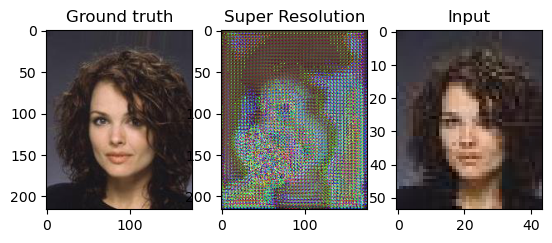

400
#########################Stats#####################
D_x :  0.99996018409729  D_G_x :  2.1464158450612558e-08  D_G_x_1 :  2.1464158450612558e-08  Error :  130.9077606201172


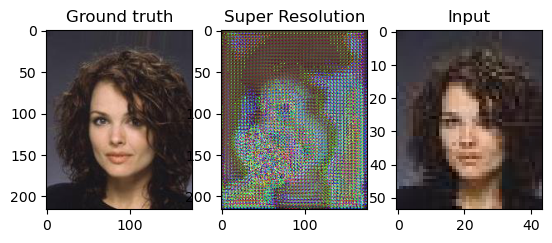

500
#########################Stats#####################
D_x :  0.9999417066574097  D_G_x :  1.6056856111390516e-07  D_G_x_1 :  1.6056856111390516e-07  Error :  160.75100708007812


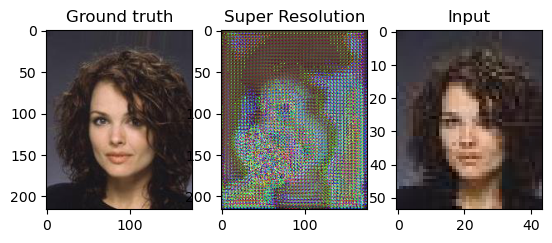

600
#########################Stats#####################
D_x :  1.0  D_G_x :  1.495255724792699e-10  D_G_x_1 :  1.495255724792699e-10  Error :  131.02633666992188


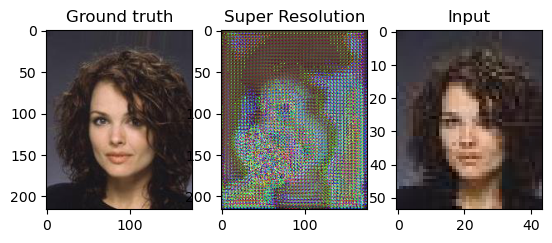

700
#########################Stats#####################
D_x :  1.0  D_G_x :  3.102302414959013e-08  D_G_x_1 :  3.102302414959013e-08  Error :  136.4479522705078


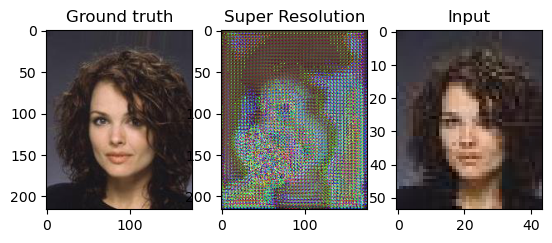

800
#########################Stats#####################
D_x :  0.9999998807907104  D_G_x :  6.75120691084885e-06  D_G_x_1 :  6.75120691084885e-06  Error :  166.88072204589844


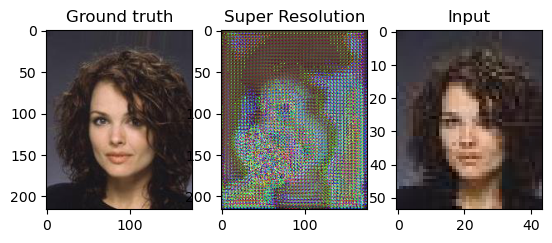

900
#########################Stats#####################
D_x :  1.0  D_G_x :  1.2765322310315241e-07  D_G_x_1 :  1.2765322310315241e-07  Error :  133.04904174804688


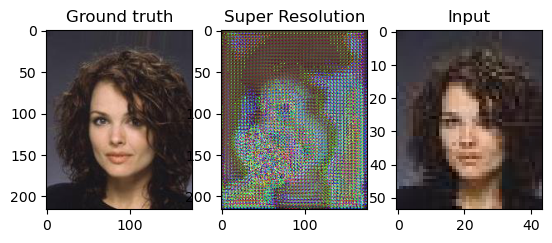

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  6.660189228568925e-06  D_G_x_1 :  6.660189228568925e-06  Error :  156.01971435546875


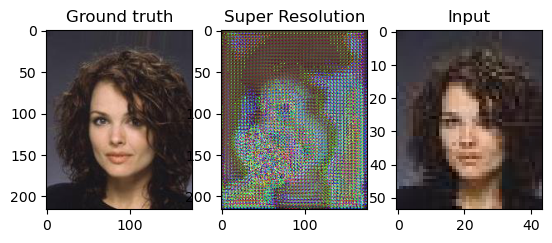

100
#########################Stats#####################
D_x :  1.0  D_G_x :  4.458399160967019e-08  D_G_x_1 :  4.458399160967019e-08  Error :  130.8094940185547


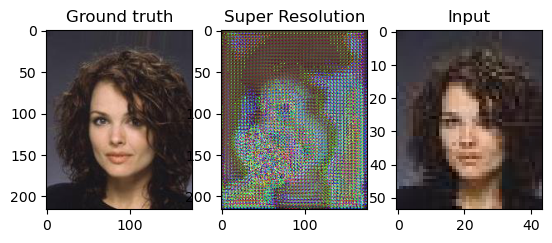

200
#########################Stats#####################
D_x :  0.9969117045402527  D_G_x :  3.41358457944807e-07  D_G_x_1 :  3.41358457944807e-07  Error :  151.93719482421875


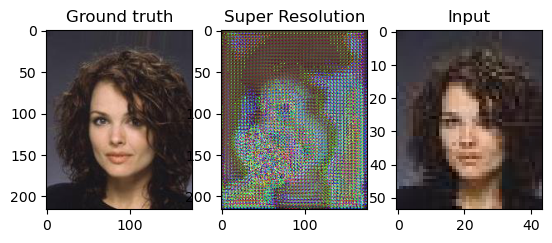

300
#########################Stats#####################
D_x :  0.9998995065689087  D_G_x :  5.172610118009402e-10  D_G_x_1 :  5.172610118009402e-10  Error :  142.0520477294922


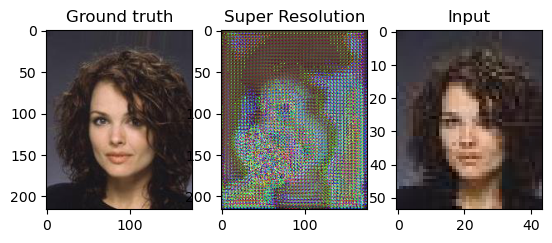

400
#########################Stats#####################
D_x :  0.9999999403953552  D_G_x :  5.677030756601198e-08  D_G_x_1 :  5.677030756601198e-08  Error :  146.66131591796875


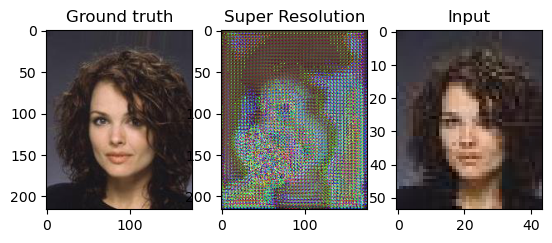

500
#########################Stats#####################
D_x :  0.9994063973426819  D_G_x :  1.0777566927799853e-07  D_G_x_1 :  1.0777566927799853e-07  Error :  136.2916717529297


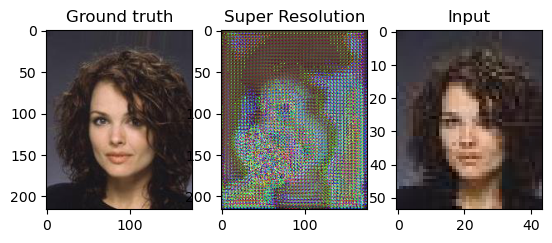

600
#########################Stats#####################
D_x :  0.9999996423721313  D_G_x :  8.525955763616366e-08  D_G_x_1 :  8.525955763616366e-08  Error :  137.29327392578125


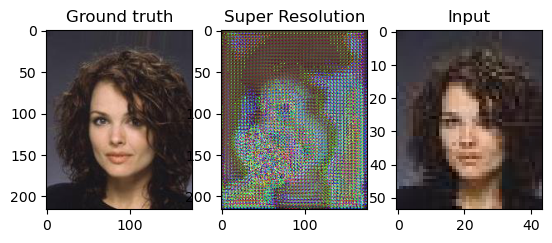

700
#########################Stats#####################
D_x :  1.0  D_G_x :  1.0959422258594032e-09  D_G_x_1 :  1.0959422258594032e-09  Error :  143.62681579589844


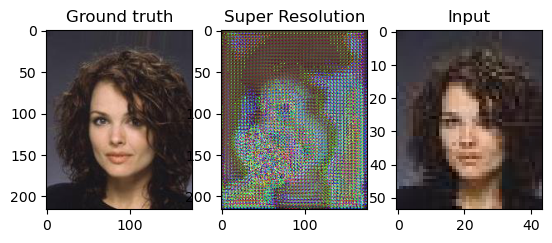

800
#########################Stats#####################
D_x :  1.0  D_G_x :  5.801209290723364e-09  D_G_x_1 :  5.801209290723364e-09  Error :  132.3880615234375


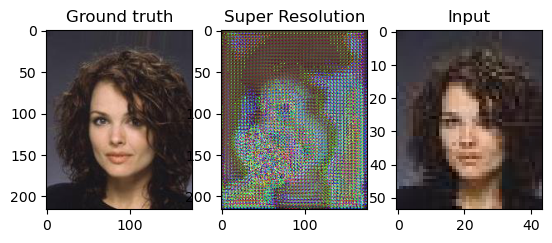

900
#########################Stats#####################
D_x :  0.9999998807907104  D_G_x :  2.572448254412052e-09  D_G_x_1 :  2.572448254412052e-09  Error :  157.3515167236328


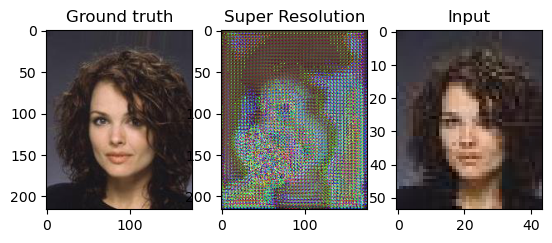

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  5.742490927218569e-10  D_G_x_1 :  5.742490927218569e-10  Error :  127.3228759765625


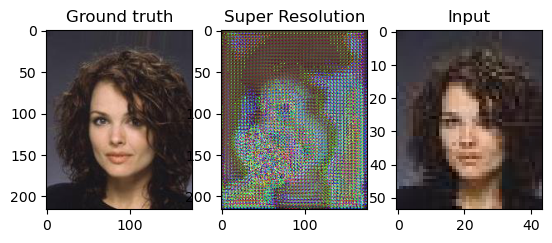

100
#########################Stats#####################
D_x :  1.0  D_G_x :  2.999046955665108e-06  D_G_x_1 :  2.999046955665108e-06  Error :  135.28224182128906


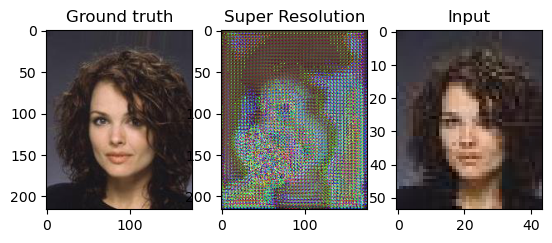

200
#########################Stats#####################
D_x :  1.0  D_G_x :  4.9498609655529435e-08  D_G_x_1 :  4.9498609655529435e-08  Error :  139.1280517578125


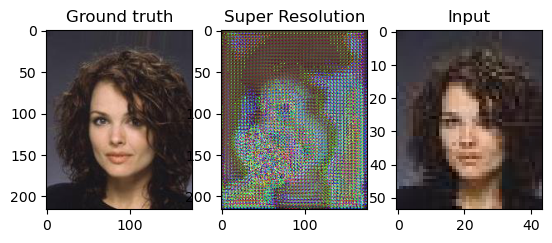

300
#########################Stats#####################
D_x :  1.0  D_G_x :  1.1336269700734647e-09  D_G_x_1 :  1.1336269700734647e-09  Error :  130.74237060546875


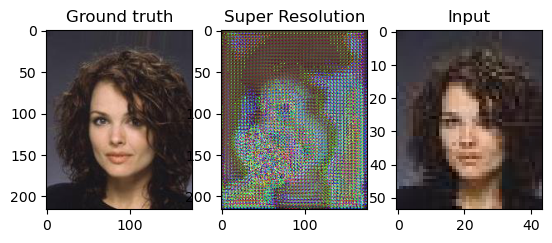

400
#########################Stats#####################
D_x :  0.9695671796798706  D_G_x :  1.088973622387357e-08  D_G_x_1 :  1.088973622387357e-08  Error :  167.28675842285156


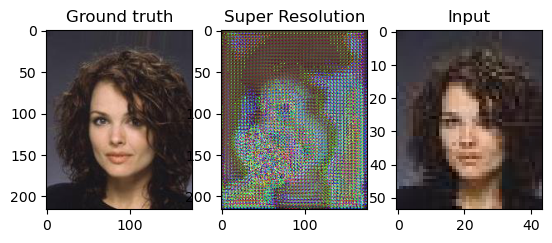

500
#########################Stats#####################
D_x :  0.9999999403953552  D_G_x :  8.062691847499082e-09  D_G_x_1 :  8.062691847499082e-09  Error :  126.3336410522461


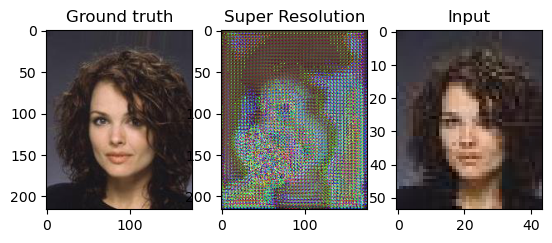

600
#########################Stats#####################
D_x :  0.9999684691429138  D_G_x :  6.232882697077002e-06  D_G_x_1 :  6.232882697077002e-06  Error :  140.7323455810547


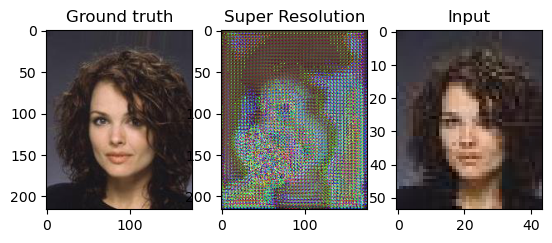

700
#########################Stats#####################
D_x :  1.0  D_G_x :  4.569909339835476e-09  D_G_x_1 :  4.569909339835476e-09  Error :  144.55738830566406


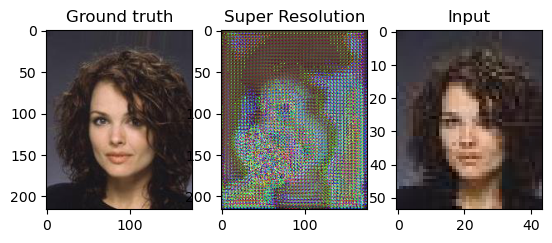

800
#########################Stats#####################
D_x :  1.0  D_G_x :  5.49926060244843e-09  D_G_x_1 :  5.49926060244843e-09  Error :  146.9407501220703


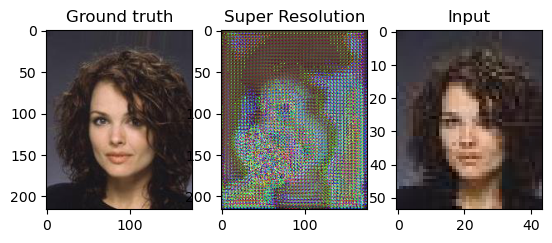

900
#########################Stats#####################
D_x :  1.0  D_G_x :  3.2608435951431147e-09  D_G_x_1 :  3.2608435951431147e-09  Error :  140.76388549804688


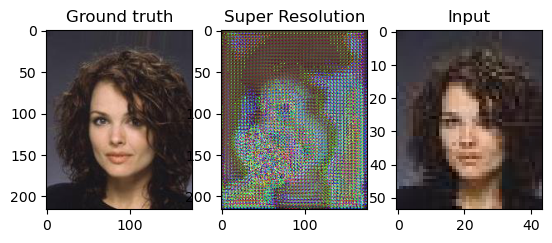

1000
#########################Stats#####################
D_x :  1.0  D_G_x :  9.385997756794495e-09  D_G_x_1 :  9.385997756794495e-09  Error :  141.48011779785156


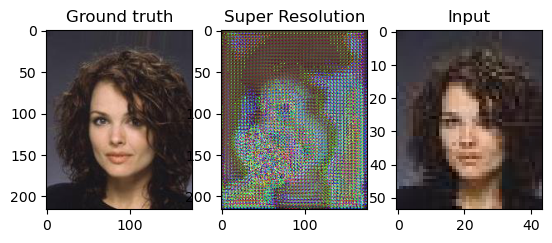

100
#########################Stats#####################
D_x :  1.0  D_G_x :  4.642715656366647e-10  D_G_x_1 :  4.642715656366647e-10  Error :  166.53297424316406


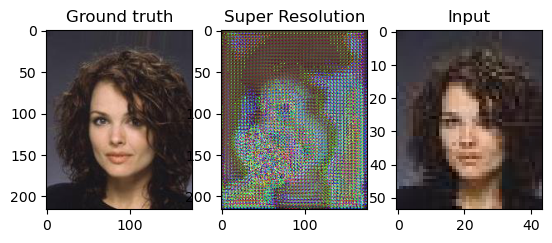

200
#########################Stats#####################
D_x :  1.0  D_G_x :  2.5069493148066613e-08  D_G_x_1 :  2.5069493148066613e-08  Error :  161.88014221191406


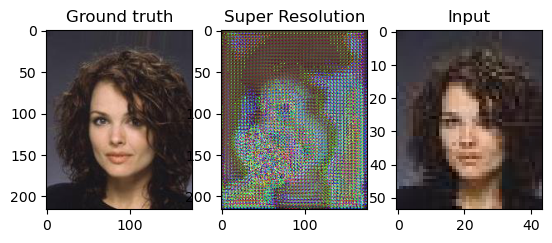

300
#########################Stats#####################
D_x :  1.0  D_G_x :  3.74609498976497e-08  D_G_x_1 :  3.74609498976497e-08  Error :  135.8661346435547


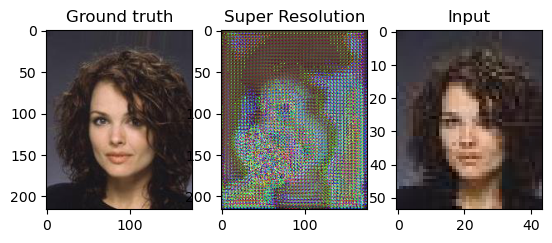

400
#########################Stats#####################
D_x :  1.0  D_G_x :  6.7081313837036305e-09  D_G_x_1 :  6.7081313837036305e-09  Error :  129.0712127685547


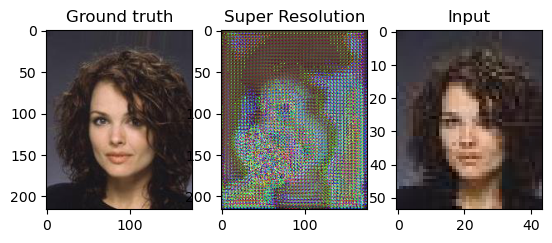

500
#########################Stats#####################
D_x :  1.0  D_G_x :  2.8373614568977246e-10  D_G_x_1 :  2.8373614568977246e-10  Error :  117.1507797241211


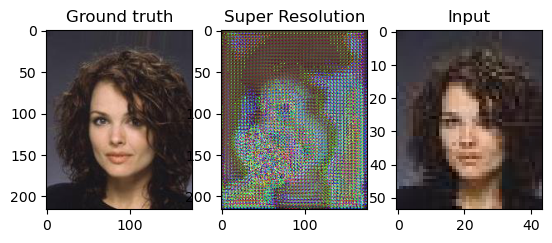

600
#########################Stats#####################
D_x :  1.0  D_G_x :  1.9661978711837946e-09  D_G_x_1 :  1.9661978711837946e-09  Error :  134.33245849609375


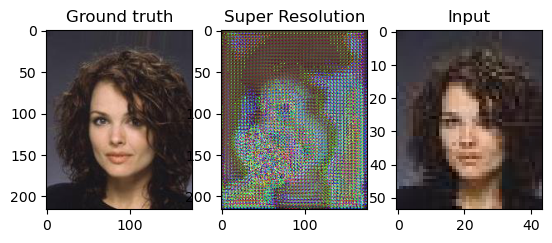

700
#########################Stats#####################
D_x :  1.0  D_G_x :  8.492271330595713e-10  D_G_x_1 :  8.492271330595713e-10  Error :  139.07400512695312


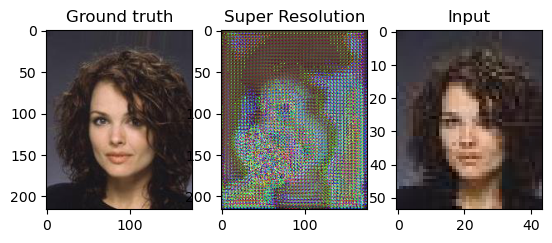

800
#########################Stats#####################
D_x :  1.0  D_G_x :  2.6993302038036404e-10  D_G_x_1 :  2.6993302038036404e-10  Error :  139.45718383789062


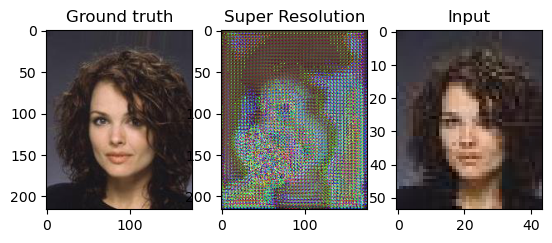

900
#########################Stats#####################
D_x :  1.0  D_G_x :  1.5649850126919773e-07  D_G_x_1 :  1.5649850126919773e-07  Error :  139.60997009277344


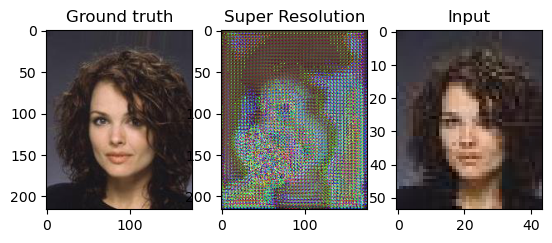

1000
#########################Stats#####################
D_x :  0.9905946850776672  D_G_x :  2.494244881745544e-07  D_G_x_1 :  2.494244881745544e-07  Error :  159.02410888671875


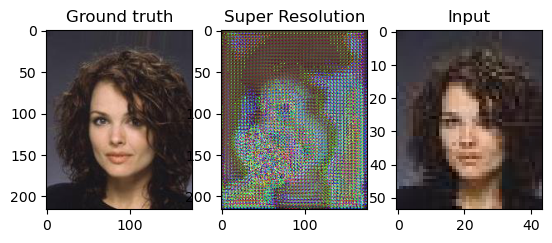

In [37]:
for epoch in range(5):
    count = 0
    for sr_img, hr_img in train_loader:
               
        # Train the Discriminator
        
        Dis.zero_grad()
        
        sr_img = sr_img.cuda()
        hr_img = hr_img.cuda()
        
        out_D = Dis(hr_img)
        
        bsize = sr_img.size(0)
        label = torch.full((bsize,1), 1, device='cuda')
        label = label.float()
        
        errD_real = loss_clf(out_D, label)
        
        errD_real.backward(retain_graph=True)
        D_x = out_D.mean().item()
        
        # Get the Fake images 
        
        fake = Gen(sr_img)
        
        out_D_G = Dis(fake)
        
        label = torch.full((bsize,1), 0, device='cuda')
        label = label.float()
        errD_fake = loss_clf(out_D_G, label)
        
        errD_fake.backward(retain_graph=True)
        D_G_x = out_D_G.mean().item()
        
        errD = errD_fake + errD_real
        
        # Update Discriminator
        
        optimizerD.step()
        
        # Train the Generator
        
        Gen.zero_grad()
        
        # pass both the Hr and fake to VGG and compute mse on that.
        
        with torch.no_grad():
            fake_vgg = vgg(fake)

            hr_vgg = vgg(hr_img)
        
        errG = torch.dist(fake_vgg, hr_vgg)
        
        out_D_G_1 = Dis(fake)
        label = torch.full((bsize,1), 1, device='cuda')
        label = label.float()
        e_g = loss_clf(out_D_G_1, label)
        D_G_1 = out_D_G_1.mean().item()
        
        errG = errG + 0.001*e_g # Check paper perceptual loss
        
        errG.backward(retain_graph=True)
        
        # Update the Generator
        
        optimizerG.step()
        
        count = count + 1
        
        if count%100 == 0:
            with torch.no_grad():
                
                print(count)
                
                print("#########################Stats#####################")
                
                print("D_x : ", D_x, " D_G_x : ", D_G_x, " D_G_x_1 : ", D_G_1, " Error : ", errG.item())
                
                f, (ax1, ax2, ax3) = plt.subplots(1, 3)

                c = 0
                for sr, hr in val_loader:
                    if c == 0:
                        sr_rel = sr.cuda()
                        hr_rel = hr.cuda()
                        fk = Gen(sr_rel)
                    c = c + 1
                
                img = np.transpose(hr_rel.cpu().numpy()[0,:,:,:], (1, 2, 0))
                img = (img)*255
                img = img.astype(np.uint8)
                ax1.imshow(img)
                ax1.set_title('Ground truth')
                
                imgf = np.transpose(fk.cpu().numpy()[0,:,:,:], (1, 2, 0))
                imgf = (imgf)*255
                imgf = imgf.astype(np.uint8)
                ax2.imshow(imgf)
                ax2.set_title('Super Resolution')
                
                imgi = np.transpose(sr_rel.cpu().numpy()[0,:,:,:], (1, 2, 0))
                imgi = (imgi)*255
                imgi = imgi.astype(np.uint8)
                ax3.imshow(imgi)
                ax3.set_title('Input')
                
                plt.show()
    
    torch.save(Gen.state_dict(),model_path+'Gen_vgg_'+str(epoch)+'.pth')
    torch.save(Dis.state_dict(),model_path+'Dis_vgg_'+str(epoch)+'.pth')